##Загрузки

In [ ]:
!pip install -U git+https://github.com/albumentations-team/albumentations

  Cloning https://github.com/albumentations-team/albumentations to /tmp/pip-req-build-bxovc3vx
  Running command git clone -q https://github.com/albumentations-team/albumentations /tmp/pip-req-build-bxovc3vx
     |████████████████████████████████| 952kB 17.8MB/s 
  Created wheel for albumentations: filename=albumentations-0.5.2-cp37-none-any.whl size=88321 sha256=0dff4c91c84d445f01ec91546b96ed5e349dec25a0be7071ef4768288df43385
  Stored in directory: /tmp/pip-ephem-wheel-cache-z1xxu2og/wheels/6f/77/82/86baf8aeda64a6de0f890cd0f2fb31acaf5545cc9c99ad21ba
Successfully built albumentations
  Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
  Found existing installation: albumentations 0.1.12
    Uninstalling albumentations-0.1.12:
      Successfully uninstalled albumentations-0.1.12


In [ ]:
!wget -q https://datasets.d2.mpi-inf.mpg.de/andriluka14cvpr/mpii_human_pose_v1.tar.gz

In [ ]:
!tar -xzf /content/mpii_human_pose_v1.tar.gz

In [ ]:
!rm /content/mpii_human_pose_v1.tar.gz

rm: cannot remove '/content/mpii_human_pose_v1.tar.gz': No such file or directory


In [ ]:
!gdown https://drive.google.com/uc?id=1m2Yv37zmwmTTpoxMYD_YtS291BUa2VsF

Downloading...
From: https://drive.google.com/uc?id=1m2Yv37zmwmTTpoxMYD_YtS291BUa2VsF
To: /content/trainval.json
40.6MB [00:00, 98.1MB/s]


In [ ]:
!gdown https://drive.google.com/uc?id=1Di7CeasT_tggv7dXFWny0k0PQukGmO6d

Downloading...
From: https://drive.google.com/uc?id=1Di7CeasT_tggv7dXFWny0k0PQukGmO6d
To: /content/train.json
31.0MB [00:00, 98.8MB/s]


## Импорты, предобработка

In [ ]:
import sys
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import cv2
import albumentations as A
from albumentations.pytorch import ToTensor
import colorsys
import random
import json
import numpy as np
import matplotlib.pyplot as plt
from torchvision.models import mobilenet_v2
from  torchvision.models import densenet121
%matplotlib inline

sys.path.insert(1, '/content/gdrive/My Drive')
from tqdm.notebook import tqdm
import colorsys
import random

device = torch.device('cuda:0')
# device = torch.device('cpu')

In [ ]:
from sklearn.metrics import pairwise_distances

In [ ]:
json_path = 'train.json'
json_path_val = 'trainval.json'

In [ ]:
def json_to_dict_of_joints(json_path):
    with open(json_path) as json_file:
        data = json.load(json_file)
    dict_of_joints = {}
    for elem in data:
        if elem['image'] in dict_of_joints.keys():
            dict_of_joints[elem['image']].append(elem['joints'])
        else:
            dict_of_joints[elem['image']] = [elem['joints']]
    return dict_of_joints

In [ ]:
dict_of_joints = json_to_dict_of_joints(json_path)
dict_of_joints_val = json_to_dict_of_joints(json_path_val)

In [ ]:
imgs_names = list(dict_of_joints.keys())

In [ ]:
val = {}
for x in dict_of_joints_val.keys():
    if x not in dict_of_joints.keys():
        val[x] = dict_of_joints_val[x]

In [ ]:
def random_colors(N, bright=True):
    """
    Generate random colors.
    To get visually distinct colors, generate them in HSV space then convert to RGB.
    """
    brightness = 1.0 if bright else 0.7
    hsv = [(i / N, 1, brightness) for i in range(N)]
    colors = list(map(lambda c: colorsys.hsv_to_rgb(*c), hsv))
    random.shuffle(colors)
    return colors

def plot_img_with_joints(image_name, image_path, dict_of_joints):
    _, ax = plt.subplots(1)
    ax.axis('off')
    path = image_path + image_name
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    joints = np.array(dict_of_joints[image_name])
    colors = random_colors(len(joints))
    for single_pose, color in zip(joints, colors):
        ax.scatter(single_pose[9, 0],
                   single_pose[9, 1],
                   c = [color] * 1)
    ax.imshow(img)
    plt.show()

In [ ]:
class MPII_Train(Dataset):
    def __init__(self, dict_of_joints, images_path, list_of_transforms):
        self.images_path = images_path
        self.dict_of_joints = dict_of_joints
        self.list_of_names = list(dict_of_joints.keys())
        self.list_of_transforms = list_of_transforms
        self.class_labels = np.array(['r ankle',
                             'r knee', 
                             'r hip', 
                             'l hip', 
                             'l knee',
                             'l ankle', 
                             'pelvis', 
                             'thorax', 
                             'upper neck', 
                             'head top', 
                             'r wrist', 
                             'r elbow', 
                             'r shoulder', 
                             'l shoulder', 
                             'l elbow', 
                             'l wrist'])
        
        self.class_labels_to_channel = {'r ankle':0,
                                        'r knee':1, 
                                        'r hip':2, 
                                        'l hip':3, 
                                        'l knee':4,
                                        'l ankle':5, 
                                        'pelvis':6, 
                                        'thorax':7, 
                                        'upper neck':8, 
                                        'head top':9, 
                                        'r wrist':10, 
                                        'r elbow':11, 
                                        'r shoulder':12, 
                                        'l shoulder':13, 
                                        'l elbow':14, 
                                        'l wrist':15}
    
    def __len__(self):
        return len(self.list_of_names)
    
    def __getitem__(self, idx):
        img_name = self.list_of_names[idx]
        img = cv2.imread(self.images_path + img_name)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        pose_joints = []
        pose_labels = []
        joints = self.dict_of_joints[img_name]
        eps = 1.1
        for person in joints:
            person_joint = np.array(person)
            person_labels = self.class_labels[(person_joint > 0)[:, 1]]
            person_joint = person_joint[(person_joint > 0)[:, 1]]

            person_labels = person_labels[person_joint[:, 1] < img.shape[0] + 1]
            person_joint = person_joint[person_joint[:, 1] < img.shape[0] + 1]
            person_labels = person_labels[person_joint[:, 0] < img.shape[1] + 1]
            person_joint = person_joint[person_joint[:, 0] < img.shape[1] + 1]
            person_labels = person_labels[person_joint[:, 1] > -1]
            person_joint = person_joint[person_joint[:, 1] > -1]
            person_labels = person_labels[person_joint[:, 0] > -1]
            person_joint = person_joint[person_joint[:, 0] > -1]
           

            person_joint[:, 1] = np.where(person_joint[:, 1] < img.shape[0],
                                    person_joint[:, 1],
                                    person_joint[:, 1] - eps)

            person_joint[:, 0] = np.where(person_joint[:, 0] < img.shape[1],
                                    person_joint[:, 0],
                                    person_joint[:, 0] - eps)

            person_joint[:, 1] = np.where(person_joint[:, 1] > 0,
                                    person_joint[:, 1],
                                    person_joint[:, 1] + eps)
            
            person_joint[:, 0] = np.where(person_joint[:, 0] > 0,
                                    person_joint[:, 0],
                                    person_joint[:, 0] + eps)

            pose_joints += list(person_joint)
            pose_labels += list(person_labels)

        num_persons = len(joints)

        transform = A.Compose(
            self.list_of_transforms,
            keypoint_params=A.KeypointParams(
                format='xy',
                label_fields=['class_labels'],
                remove_invisible=True,
                check_each_transform=False
                )
        )
        transformed = transform(image=img,
                                keypoints=pose_joints,
                                class_labels=pose_labels
                                )

        pose_mask = np.zeros((16, 64, 64)).astype(float)
        
        for label, joint in zip(transformed['class_labels'],
                                transformed['keypoints']):
            h = (np.arange(64) - int(joint[1] / 4)) ** 2 
            w = (np.arange(64) - int(joint[0] / 4)) ** 2 

            pose_mask[self.class_labels_to_channel[label]] += np.exp(-0.5 * (np.sqrt(np.ones((64, 64)) * h[:, None] + np.ones((64, 64)) * w)))

        target = np.zeros((64, 64))
        for label, joint in zip(transformed['class_labels'],
                                 transformed['keypoints']):
            target[int(joint[1] / 4), int(joint[0] / 4)] = self.class_labels_to_channel[label] + 1

        return (transformed['image'].type(torch.float32),
                torch.from_numpy(target).type(torch.long),
                torch.from_numpy(pose_mask).type(torch.float32))

        # return (transformed['image'].type(torch.float32),
        #  torch.from_numpy(pose_mask).type(torch.float32))

## Модель

In [ ]:
class SGSK(nn.Module):
    def __init__(self, num_joints):
        super(SGSK, self).__init__()

        self.Input_layer = nn.Sequential(
            nn.Conv2d(3, 32, 2, 2),
            nn.BatchNorm2d(32),
            nn.ReLU6(),
            nn.ConvTranspose2d(32, 32, 3),
            nn.Conv2d(32, 32, 3),
            nn.BatchNorm2d(32),
            nn.ReLU6(),
            nn.Conv2d(32, 64, 2, 2),
            nn.BatchNorm2d(64),
            nn.ReLU6(),
            nn.ConvTranspose2d(64, 64, 3),
            nn.Conv2d(64, 64, 3),
            nn.BatchNorm2d(64),
            nn.ReLU6()
        )
        #n x 64 x 64 x 64

        self.skip_param_0 = torch.nn.Parameter(torch.rand(1))

        self.encoder_layer_1 = nn.Sequential(
            nn.Conv2d(64, 128, 2, 2),
            nn.BatchNorm2d(128),
            nn.ReLU6(),
            nn.ConvTranspose2d(128, 128, 3),
            nn.BatchNorm2d(128),
            nn.ReLU6(),
            nn.Conv2d(128, 128, 3),
            nn.BatchNorm2d(128),
            nn.ReLU6()
        )
        #n x 128 x 32 x 32

        self.skip_param_1 = torch.nn.Parameter(torch.rand(1))

        self.encoder_layer_2 = nn.Sequential(
            nn.Conv2d(128, 256, 2, 2),
            nn.BatchNorm2d(256),
            nn.ReLU6(),
            nn.ConvTranspose2d(256, 256, 3),
            nn.BatchNorm2d(256),
            nn.ReLU6(),
            nn.Conv2d(256, 256, 3),
            nn.BatchNorm2d(256),
            nn.ReLU6()
        )

        #n x 256 x 16 x 16

        self.skip_param_2 = torch.nn.Parameter(torch.rand(1))

        self.encoder_layer_3 = nn.Sequential(
            nn.Conv2d(256, 512, 2, 2),
            nn.BatchNorm2d(512),
            nn.ReLU6(),
            nn.ConvTranspose2d(512, 512, 3),
            nn.BatchNorm2d(512),
            nn.ReLU6(),
            nn.Conv2d(512, 512, 3),
            nn.BatchNorm2d(512),
            nn.ReLU6()
        )

        #n x 512 x 8 x 8

        self.decoder_layer_2 = nn.Sequential(
            nn.ConvTranspose2d(512, 256, 2, 2),
            nn.BatchNorm2d(256),
            nn.ReLU6(),
            nn.ConvTranspose2d(256, 256, 3),
            nn.BatchNorm2d(256),
            nn.ReLU6(),
            nn.Conv2d(256, 256, 3),
            nn.BatchNorm2d(256),
            nn.ReLU6()
        )

        #n x 256 x 16 x 16

        self.decoder_layer_1 = nn.Sequential(
            nn.ConvTranspose2d(256, 128, 2, 2),
            nn.BatchNorm2d(128),
            nn.ReLU6(),
            nn.ConvTranspose2d(128, 128, 3),
            nn.BatchNorm2d(128),
            nn.ReLU6(),
            nn.Conv2d(128, 128, 3),
            nn.BatchNorm2d(128),
            nn.ReLU6()
        )

        self.decoder_layer_0 = nn.Sequential(
            nn.ConvTranspose2d(128, 64, 2, 2),
            nn.BatchNorm2d(64),
            nn.ReLU6(),
            nn.ConvTranspose2d(64, 64, 3),
            nn.BatchNorm2d(64),
            nn.ReLU6(),
            nn.Conv2d(64, 64, 3),
            nn.BatchNorm2d(64),
            nn.ReLU6()
        )

        self.Output_layer = nn.Sequential(
            nn.ConvTranspose2d(64, 64, 3),
            nn.BatchNorm2d(64),
            nn.ReLU6(),
            nn.Conv2d(64, 64, 3),
            nn.BatchNorm2d(64),
            nn.ReLU6(),
            nn.Conv2d(64, num_joints, 1)
        )
    
    def forward(self, x):
        x0 = self.Input_layer(x)

        x1 = self.encoder_layer_1(x0)

        x2 = self.encoder_layer_2(x1)

        x = self.encoder_layer_3(x2)

        x = self.decoder_layer_2(x) + self.skip_param_2 * x2

        x = self.decoder_layer_1(x) + self.skip_param_1 * x1

        x = self.decoder_layer_0(x) + self.skip_param_0 * x0

        return self.Output_layer(x)

In [ ]:
class Custom_Loss(nn.Module):
    def __init__(self, loss_type):
        super(Custom_Loss, self).__init__()
        self.class_criterion = torch.nn.CrossEntropyLoss(reduction='none')
        self.regr_criterion = torch.nn.MSELoss()
        self.loss_type = loss_type

    def forward(self,
                pred_mask, #N x 17 x 64 x 64
                true_class=None,
                true_regr=None): #N x 64 x 64

        if self.loss_type == 'cross_entropy':
            losses = self.class_criterion(pred_mask, true_class)
            loss = torch.zeros(1).type(torch.float32).to(device)
            for i in range(pred_mask.shape[1]):
                num = (true_class == i).sum()
                if num > 0:
                    loss = loss + losses[true_class == i].sum() / num
            return loss

        elif self.loss_type == 'mse':
            loss = self.regr_criterion(pred_mask, true_regr)
            return loss

## Обучение

In [ ]:
train_dataset = MPII_Train(dict_of_joints, 'images/', [A.Resize(256, 256),
                                                       A.HorizontalFlip(),
                                                       A.Rotate(15),
                                                       A.GaussNoise(),
                                                       A.Normalize((0.3, 0.3, 0.3), (0.3, 0.3, 0.3)),
                                               A.pytorch.ToTensorV2(),
                                               ])

val_dataset = MPII_Train(val, 'images/', [A.Resize(256, 256),
                                                       A.Normalize((0.3, 0.3, 0.3), (0.3, 0.3, 0.3)),
                                               A.pytorch.ToTensorV2(),
                                               ])

In [ ]:
heights = []
widths = []
head_sizes = []
points = []
for img_name in tqdm(val_dataset.list_of_names):
    img = cv2.imread(val_dataset.images_path + img_name)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h = img.shape[0]
    w = img.shape[1]
    heights.append(h)
    widths.append(w)
    true = np.array(val_dataset.dict_of_joints[img_name])
    hs = np.linalg.norm(true[:, 8] - true[:, 9], axis=1)
    head_sizes.append(hs)
    points.append(true)
heights = np.array(heights)
widths = np.array(widths)

In [ ]:
def decode_classification_rezult(rezult, heights, widths, num_k=1):
    #rezult bs x 16 x 64 x 64
    tpok = torch.topk(rezult.view(rezult.shape[0], 16, -1), num_k, dim=2)
    confidences = tpok.values.cpu().detach().numpy()
    x = ((tpok.indices.cpu().detach().numpy() % 64) / 64) * widths[:, None, None]
    y = ((tpok.indices.cpu().detach().numpy() // 64) / 64) * heights[:, None, None]
    coords = np.stack([x, y], axis=3)
    return coords, confidences

def calck_pck(rezult, true_coords, heights, widths, head_sizes, conf_level=0.7, h=0.5):
    coords, confidences = decode_classification_rezult(rezult, heights, widths)
    # conf bs x 16 x 10
    # coords bs x 16 x 10 x 2
    # true bs x 16 x 2 x 17
    # head_sizes
    corrects = {}
    alls = {}    
    for j in range(16):
        corrects[j] = 0
        alls[j] = 0
        for i in range(coords.shape[0]):
            #only one person on img
            if true_coords[i].shape[0] == 1:
                # 1 16 2
                # bs x 16 x 1 x 2
                if true_coords[i][0, j, 0] > 0: 
                    corrects[j] += np.linalg.norm(true_coords[i][0, j] - coords[i, j, 0]) < head_sizes[i][0] * h
                    alls[j] += 1
    return corrects, alls

def get_precentage(corrects, alls):
    id_to_name = {
        0:'r ankle',
        1:'r knee', 
        2:'r hip', 
        3:'l hip', 
        4:'l knee',
        5:'l ankle', 
        6:'pelvis', 
        7:'thorax', 
        8:'upper neck', 
        9:'head top', 
        10:'r wrist', 
        11:'r elbow', 
        12:'r shoulder', 
        13:'l shoulder', 
        14:'l elbow', 
        15:'l wrist'
    }
    ans_dict = {}
    for i in corrects.keys():
        ans_dict[id_to_name[i]] = 100 * (corrects[i] / alls[i])
    return ans_dict

In [ ]:
def train(train_loader,
          model,
          criterion,
          optimizer,
          num_epoch,
          val_img,
          sheduler,
          val_loader,
          max_grad_norm=1,
          regr=False):
    for epoch in range(1, num_epoch + 1):
        train_loss = 0
        val_loss = 0
        for img, true_mask, true_regr in tqdm(train_loader): 
            pred_mask = model(img.to(device))
            optimizer.zero_grad()
            loss = criterion(pred_mask,
                             true_mask.to(device),
                             true_regr.to(device))
            loss.backward()
            grad_norm = nn.utils.clip_grad_norm_(model.parameters(),
                                                 max_grad_norm)
            optimizer.step()
            train_loss += loss.item()
        with torch.no_grad():
            preds = []
            for img, true_mask, true_regr in tqdm(val_loader):
                pred_mask = model(img.to(device))
                preds.append(pred_mask)
                val_loss += criterion(pred_mask,
                                     true_mask.to(device),
                                    true_regr.to(device)).item()
        if regr:
            corrects, alls = calck_pck(torch.cat(preds), points, heights, widths, head_sizes, conf_level=0.5)
            print('PCK@0.5:', get_precentage(corrects, alls))
        else:
            corrects, alls = calck_pck(F.softmax(torch.cat(preds), dim=1)[:, 1:], points, heights, widths, head_sizes, conf_level=0.5)
            print('PCK@0.5:', get_precentage(corrects, alls))
        print(f'Train Loss on epoch {epoch}: {train_loss / len(train_loader)}')
        print(f'Val Loss on epoch {epoch}: {val_loss / len(val_loader)}')
        sheduler.step()
        with torch.no_grad():
            pred = model(val_img.unsqueeze(0).to(device))
            fig, ax = plt.subplots(2, 2, figsize=(10, 16))
            ax[0][0].imshow((val_img * 0.3 + 0.3).permute(1, 2, 0).numpy())
            ax[0][1].imshow(pred[0][10 - regr].cpu().detach().numpy())
            ax[1][0].imshow((val_img * 0.3 + 0.3).permute(1, 2, 0).numpy())
            ax[1][1].imshow(pred[0][16 - regr].cpu().detach().numpy())
            plt.show()

In [ ]:
def validate_search(
          model,
          val_loader,
          search_sapce,
          is_regr=False):
    with torch.no_grad():
        preds = []
        for img, true_mask, true_regr in tqdm(val_loader):
            pred_mask = model(img.to(device))
            preds.append(pred_mask)
    if is_regr:
        for step in search_sapce:
            corrects, alls = calck_pck(torch.sigmoid(torch.cat(preds)), points, heights, widths, head_sizes, conf_level=step)
            print(f'Level {step}:', get_precentage(corrects, alls))
    else:
        for step in search_sapce:
            corrects, alls = calck_pck(F.softmax(torch.cat(preds)[:, 1:], dim=1), points, heights, widths, head_sizes, conf_level=step)
            print(f'Level {step}:', get_precentage(corrects, alls))        

# Регрессия

In [ ]:
train_loader = torch.utils.data.DataLoader(train_dataset,
                                           shuffle=True,
                                           batch_size=128,
                                           num_workers=2)

val_loader = torch.utils.data.DataLoader(val_dataset,
                                           shuffle=False,
                                           batch_size=128,
                                           num_workers=2)
model = SGSK(16).to(device)
criterion = Custom_Loss('mse')
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
sheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, 0.9)


PCK@0.5: {'r ankle': 1.1749347258485638, 'r knee': 2.577873254564984, 'r hip': 5.340223944875108, 'l hip': 5.498281786941581, 'l knee': 2.0320855614973263, 'l ankle': 4.404145077720207, 'pelvis': 7.605877268798617, 'thorax': 7.298657718120806, 'upper neck': 10.40268456375839, 'head top': 6.124161073825504, 'r wrist': 5.63973063973064, 'r elbow': 4.435146443514645, 'r shoulder': 7.2864321608040195, 'l shoulder': 5.351170568561873, 'l elbow': 3.859060402684564, 'l wrist': 5.32994923857868}
Train Loss on epoch 1: 0.0023067208897808323
Val Loss on epoch 1: 0.003837279752706704


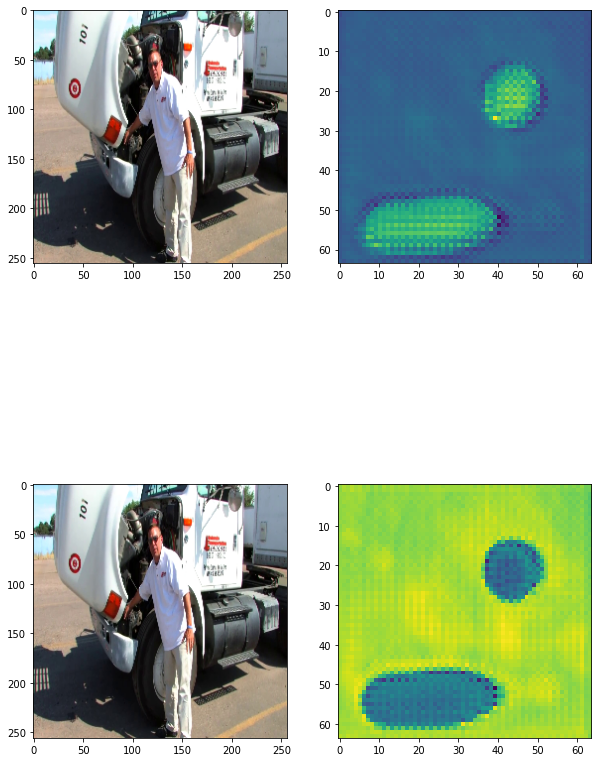


PCK@0.5: {'r ankle': 2.8720626631853787, 'r knee': 4.511278195488721, 'r hip': 11.455641688199828, 'l hip': 8.24742268041237, 'l knee': 3.5294117647058822, 'l ankle': 3.4974093264248705, 'pelvis': 9.766637856525497, 'thorax': 8.473154362416107, 'upper neck': 11.661073825503356, 'head top': 4.614093959731544, 'r wrist': 8.922558922558922, 'r elbow': 8.200836820083682, 'r shoulder': 9.296482412060302, 'l shoulder': 7.441471571906355, 'l elbow': 7.130872483221476, 'l wrist': 9.475465313028765}
Train Loss on epoch 2: 0.002242447356895908
Val Loss on epoch 2: 0.0037971704935088105


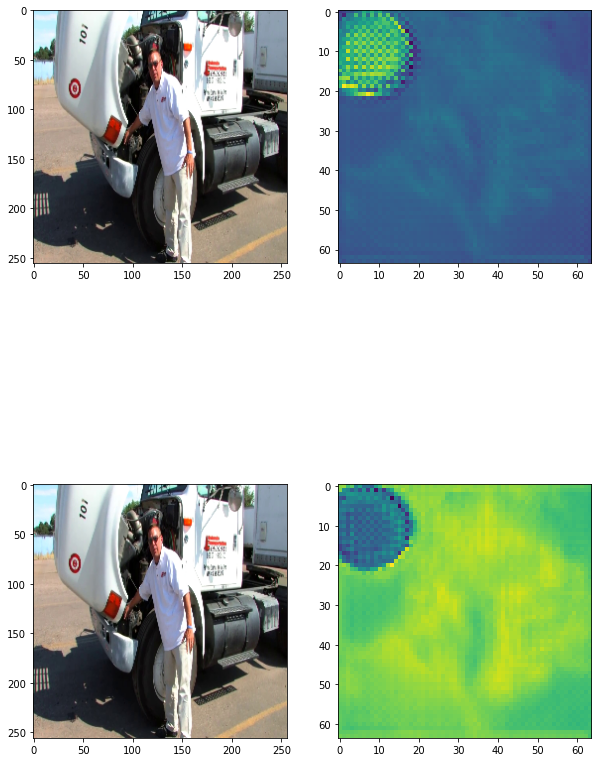


PCK@0.5: {'r ankle': 2.4804177545691903, 'r knee': 3.7593984962406015, 'r hip': 10.077519379844961, 'l hip': 7.3883161512027495, 'l knee': 5.240641711229946, 'l ankle': 4.922279792746114, 'pelvis': 7.951598962834917, 'thorax': 13.506711409395974, 'upper neck': 16.610738255033556, 'head top': 6.375838926174497, 'r wrist': 9.343434343434344, 'r elbow': 10.376569037656903, 'r shoulder': 13.651591289782244, 'l shoulder': 10.033444816053512, 'l elbow': 7.885906040268456, 'l wrist': 9.644670050761421}
Train Loss on epoch 3: 0.00221065158409107
Val Loss on epoch 3: 0.0037130683042999844


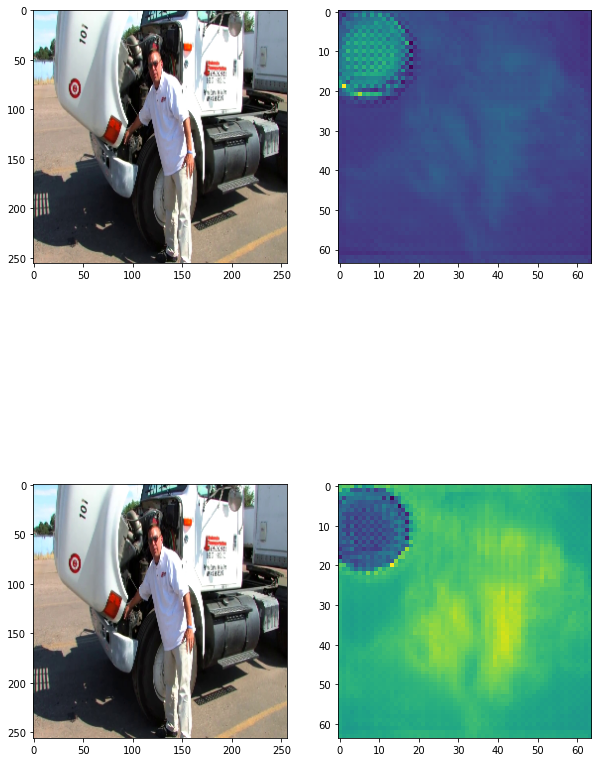


PCK@0.5: {'r ankle': 6.527415143603134, 'r knee': 5.477980665950591, 'r hip': 11.627906976744185, 'l hip': 6.701030927835052, 'l knee': 8.77005347593583, 'l ankle': 9.067357512953368, 'pelvis': 7.6923076923076925, 'thorax': 15.268456375838927, 'upper neck': 21.140939597315437, 'head top': 19.630872483221477, 'r wrist': 9.764309764309765, 'r elbow': 9.707112970711297, 'r shoulder': 13.735343383584588, 'l shoulder': 12.709030100334449, 'l elbow': 8.221476510067115, 'l wrist': 9.052453468697124}
Train Loss on epoch 4: 0.002170745182134535
Val Loss on epoch 4: 0.0035853172328485093


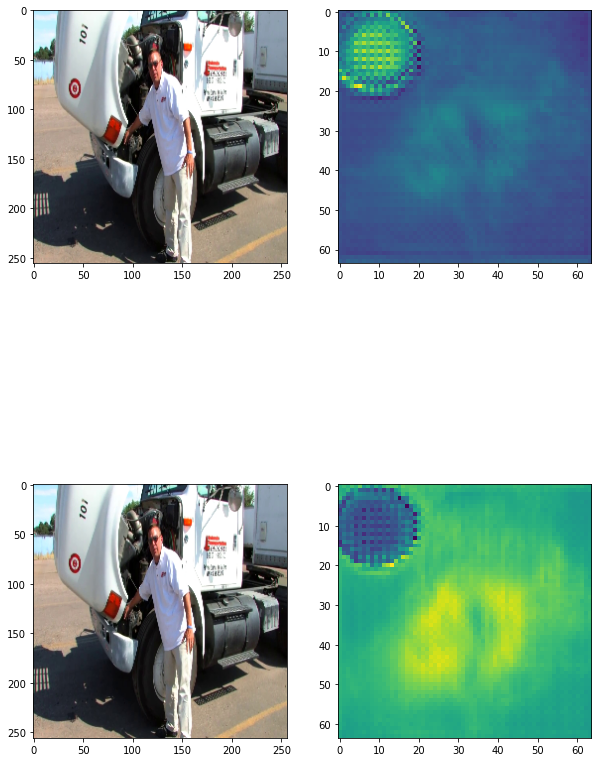


PCK@0.5: {'r ankle': 4.830287206266318, 'r knee': 4.511278195488721, 'r hip': 9.388458225667529, 'l hip': 8.505154639175258, 'l knee': 7.593582887700536, 'l ankle': 5.4404145077720205, 'pelvis': 12.532411408815902, 'thorax': 23.406040268456376, 'upper neck': 25.16778523489933, 'head top': 16.526845637583893, 'r wrist': 9.68013468013468, 'r elbow': 9.9581589958159, 'r shoulder': 15.577889447236181, 'l shoulder': 12.54180602006689, 'l elbow': 7.885906040268456, 'l wrist': 8.375634517766498}
Train Loss on epoch 5: 0.0021304662066066395
Val Loss on epoch 5: 0.003555779355456648


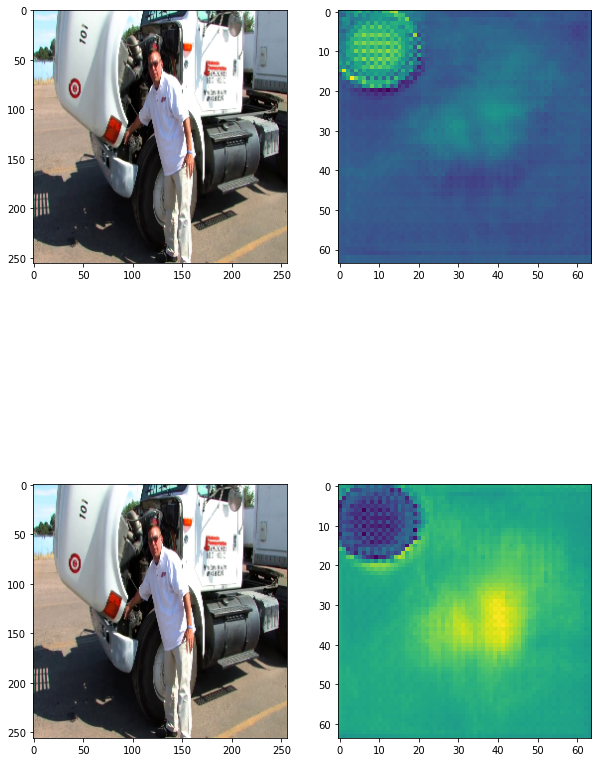


PCK@0.5: {'r ankle': 14.360313315926893, 'r knee': 9.881847475832437, 'r hip': 16.795865633074936, 'l hip': 10.481099656357388, 'l knee': 8.128342245989305, 'l ankle': 16.321243523316063, 'pelvis': 16.076058772687986, 'thorax': 24.496644295302016, 'upper neck': 26.593959731543627, 'head top': 6.208053691275168, 'r wrist': 10.942760942760943, 'r elbow': 10.209205020920502, 'r shoulder': 17.001675041876048, 'l shoulder': 12.876254180602006, 'l elbow': 8.976510067114093, 'l wrist': 9.30626057529611}
Train Loss on epoch 6: 0.0020792101692084387
Val Loss on epoch 6: 0.0036031781270614138


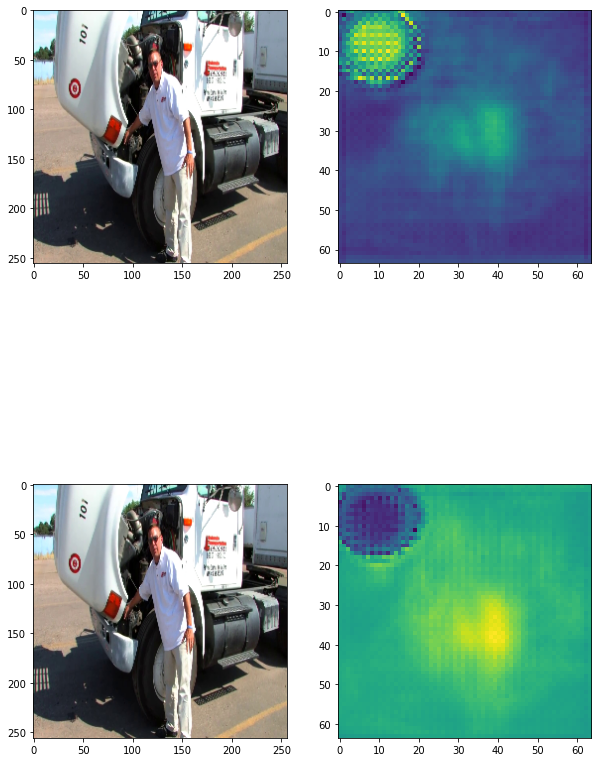


PCK@0.5: {'r ankle': 3.3942558746736298, 'r knee': 10.204081632653061, 'r hip': 17.571059431524546, 'l hip': 11.34020618556701, 'l knee': 8.449197860962567, 'l ankle': 4.404145077720207, 'pelvis': 17.804667242869492, 'thorax': 32.969798657718115, 'upper neck': 36.49328859060403, 'head top': 11.74496644295302, 'r wrist': 10.1010101010101, 'r elbow': 9.874476987447698, 'r shoulder': 19.597989949748744, 'l shoulder': 16.88963210702341, 'l elbow': 9.479865771812081, 'l wrist': 9.983079526226735}
Train Loss on epoch 7: 0.002050301265578879
Val Loss on epoch 7: 0.0033170252167822227


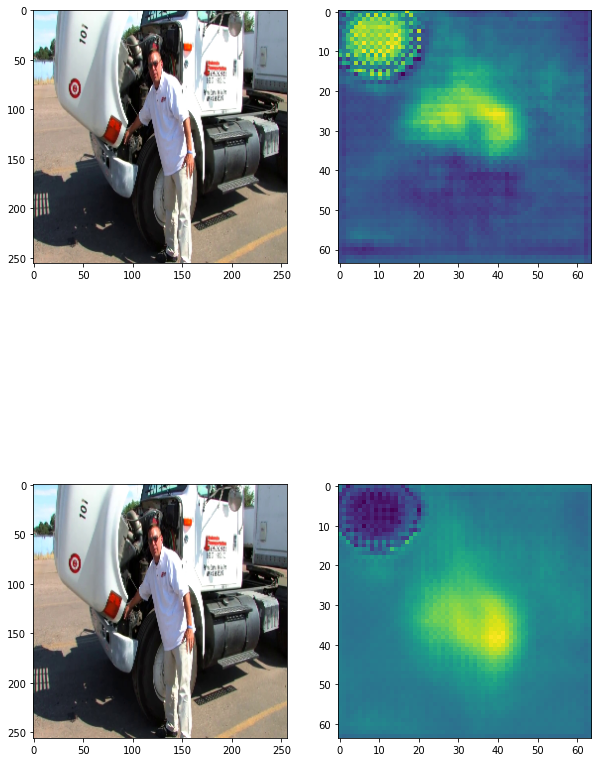


PCK@0.5: {'r ankle': 8.616187989556137, 'r knee': 11.600429645542427, 'r hip': 19.20757967269595, 'l hip': 14.948453608247423, 'l knee': 9.62566844919786, 'l ankle': 5.829015544041451, 'pelvis': 18.84183232497839, 'thorax': 42.197986577181204, 'upper neck': 44.71476510067114, 'head top': 12.751677852348994, 'r wrist': 11.363636363636363, 'r elbow': 11.297071129707113, 'r shoulder': 22.36180904522613, 'l shoulder': 19.230769230769234, 'l elbow': 9.144295302013424, 'l wrist': 10.406091370558377}
Train Loss on epoch 8: 0.002007729339453837
Val Loss on epoch 8: 0.00335067186160418


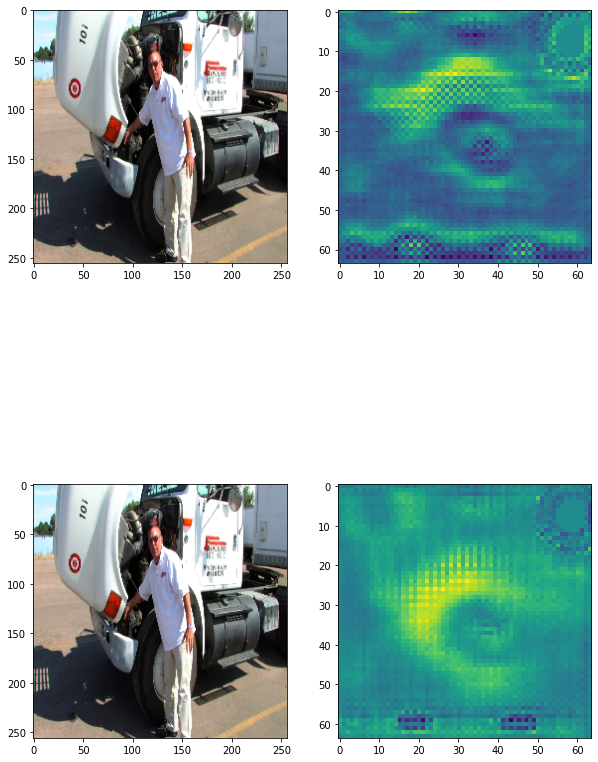


PCK@0.5: {'r ankle': 11.357702349869452, 'r knee': 14.930182599355533, 'r hip': 18.001722652885444, 'l hip': 17.353951890034363, 'l knee': 12.513368983957218, 'l ankle': 10.103626943005182, 'pelvis': 20.829732065687125, 'thorax': 42.36577181208054, 'upper neck': 43.70805369127517, 'head top': 15.268456375838927, 'r wrist': 10.26936026936027, 'r elbow': 10.96234309623431, 'r shoulder': 21.273031825795645, 'l shoulder': 18.979933110367895, 'l elbow': 8.640939597315436, 'l wrist': 9.898477157360407}
Train Loss on epoch 9: 0.0019515980713312392
Val Loss on epoch 9: 0.0032411328081608467


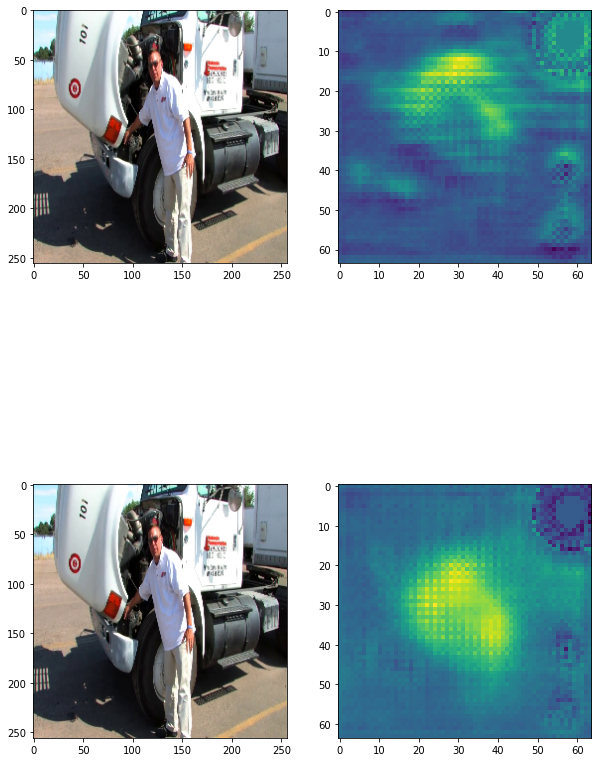


PCK@0.5: {'r ankle': 14.229765013054829, 'r knee': 14.393125671321162, 'r hip': 22.39448751076658, 'l hip': 19.072164948453608, 'l knee': 14.43850267379679, 'l ankle': 12.435233160621761, 'pelvis': 25.929127052722556, 'thorax': 52.18120805369127, 'upper neck': 51.174496644295296, 'head top': 20.889261744966444, 'r wrist': 11.447811447811448, 'r elbow': 11.129707112970712, 'r shoulder': 24.623115577889447, 'l shoulder': 22.157190635451503, 'l elbow': 8.89261744966443, 'l wrist': 11.336717428087987}
Train Loss on epoch 10: 0.0019139487377327423
Val Loss on epoch 10: 0.003122901301021161


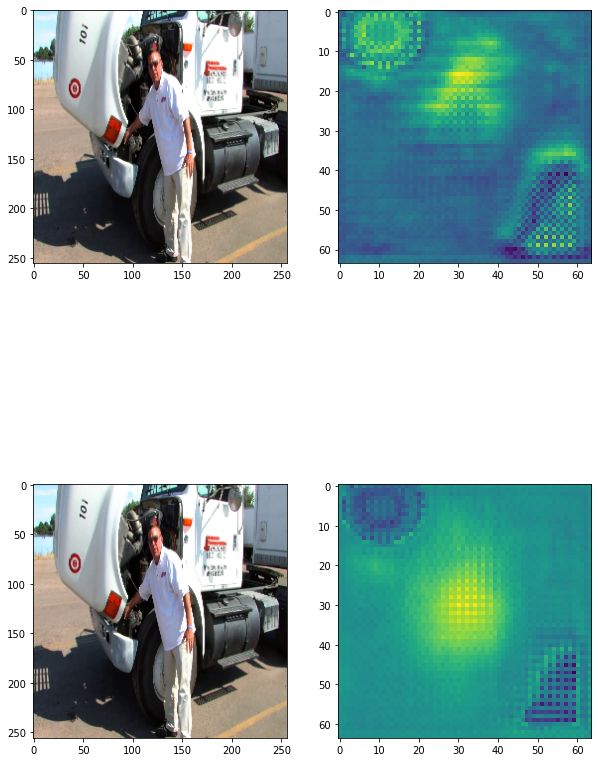


PCK@0.5: {'r ankle': 16.57963446475196, 'r knee': 18.045112781954884, 'r hip': 25.23686477174849, 'l hip': 18.04123711340206, 'l knee': 12.727272727272727, 'l ankle': 14.766839378238341, 'pelvis': 26.707000864304238, 'thorax': 55.87248322147651, 'upper neck': 54.9496644295302, 'head top': 29.36241610738255, 'r wrist': 14.057239057239057, 'r elbow': 14.644351464435147, 'r shoulder': 35.09212730318258, 'l shoulder': 21.48829431438127, 'l elbow': 9.312080536912752, 'l wrist': 11.421319796954315}
Train Loss on epoch 11: 0.001871415490851454
Val Loss on epoch 11: 0.003090020557663039


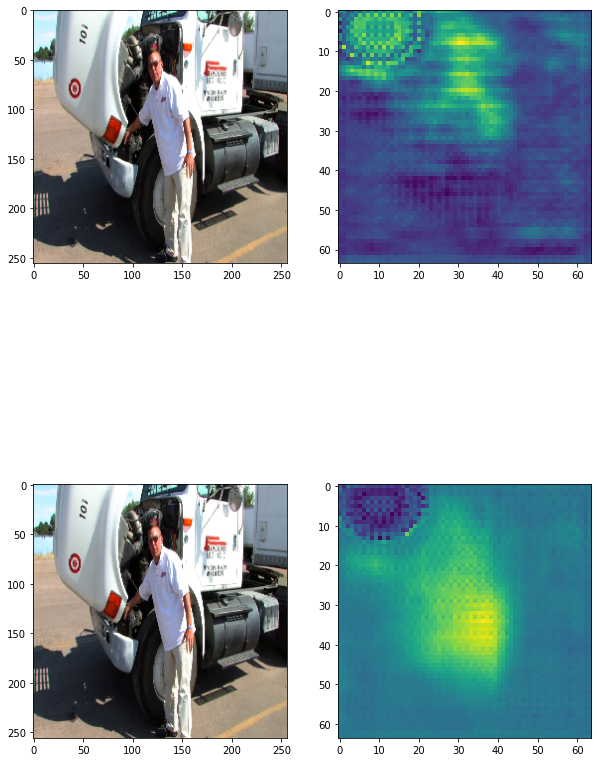


PCK@0.5: {'r ankle': 17.10182767624021, 'r knee': 17.937701396348015, 'r hip': 27.648578811369507, 'l hip': 21.563573883161514, 'l knee': 15.508021390374333, 'l ankle': 14.637305699481864, 'pelvis': 31.80639585133967, 'thorax': 58.4731543624161, 'upper neck': 60.40268456375839, 'head top': 40.26845637583892, 'r wrist': 15.151515151515152, 'r elbow': 15.732217573221757, 'r shoulder': 32.24455611390285, 'l shoulder': 26.00334448160535, 'l elbow': 10.40268456375839, 'l wrist': 14.382402707275805}
Train Loss on epoch 12: 0.0018288234289249648
Val Loss on epoch 12: 0.0030093861328761864


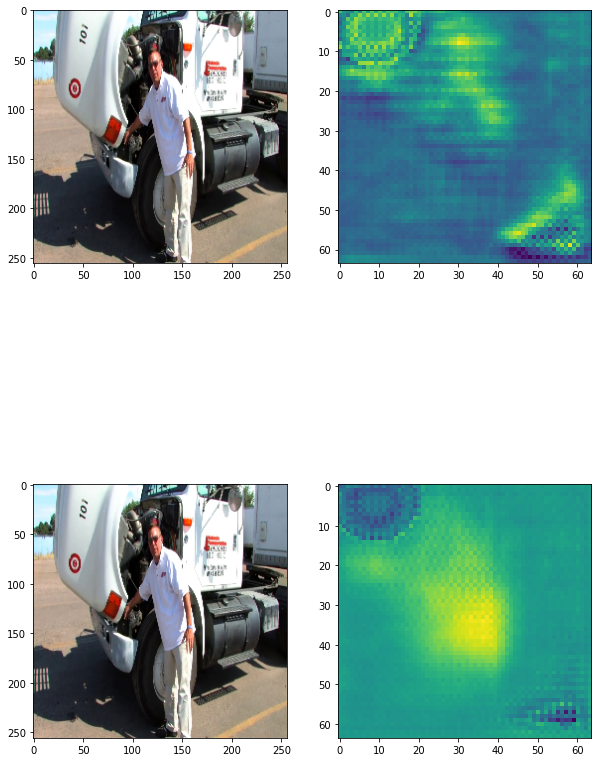


PCK@0.5: {'r ankle': 20.496083550913838, 'r knee': 16.219119226638025, 'r hip': 28.940568475452196, 'l hip': 17.439862542955325, 'l knee': 14.010695187165775, 'l ankle': 14.896373056994818, 'pelvis': 31.374243733794295, 'thorax': 60.98993288590604, 'upper neck': 61.828859060402685, 'head top': 42.86912751677852, 'r wrist': 17.087542087542086, 'r elbow': 17.154811715481173, 'r shoulder': 35.25963149078727, 'l shoulder': 25.334448160535118, 'l elbow': 9.64765100671141, 'l wrist': 14.213197969543149}
Train Loss on epoch 13: 0.001795822496363974
Val Loss on epoch 13: 0.002953944079901861


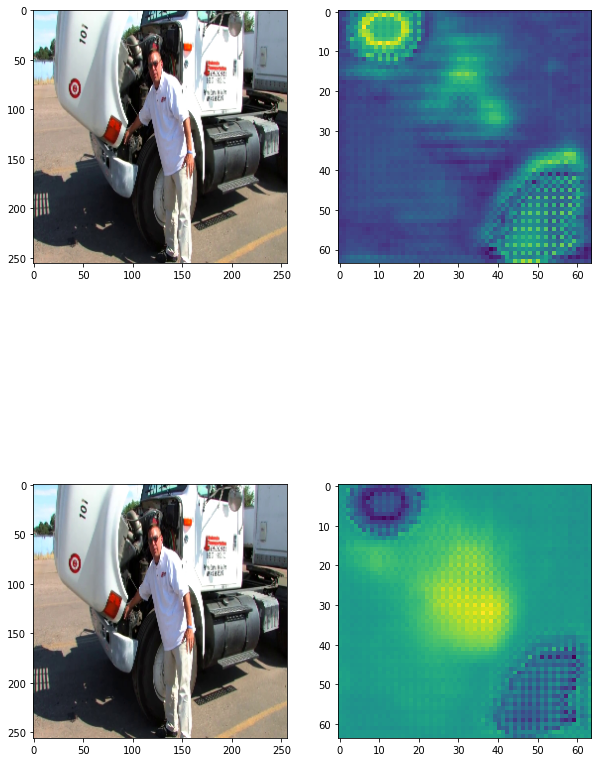


PCK@0.5: {'r ankle': 24.673629242819846, 'r knee': 19.33404940923738, 'r hip': 29.71576227390181, 'l hip': 20.103092783505154, 'l knee': 15.828877005347595, 'l ankle': 17.616580310880828, 'pelvis': 33.1028522039758, 'thorax': 63.33892617449665, 'upper neck': 65.68791946308725, 'head top': 53.60738255033557, 'r wrist': 17.17171717171717, 'r elbow': 17.322175732217573, 'r shoulder': 36.26465661641541, 'l shoulder': 25.75250836120401, 'l elbow': 11.409395973154362, 'l wrist': 16.49746192893401}
Train Loss on epoch 14: 0.0017575763155827703
Val Loss on epoch 14: 0.0028830291652728033


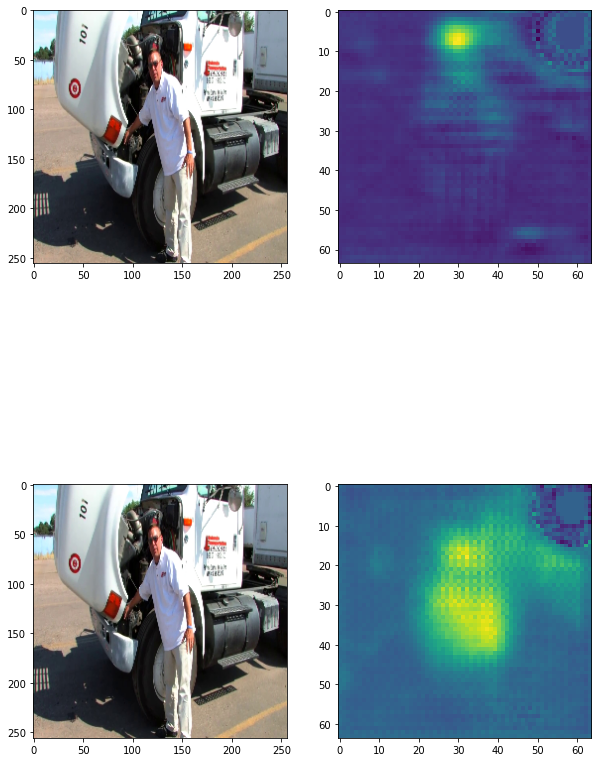


PCK@0.5: {'r ankle': 22.715404699738905, 'r knee': 18.904403866809883, 'r hip': 31.007751937984494, 'l hip': 26.632302405498283, 'l knee': 15.828877005347595, 'l ankle': 18.65284974093264, 'pelvis': 37.94295592048401, 'thorax': 66.86241610738254, 'upper neck': 68.03691275167785, 'head top': 56.04026845637584, 'r wrist': 15.067340067340067, 'r elbow': 18.326359832635983, 'r shoulder': 34.25460636515913, 'l shoulder': 27.0066889632107, 'l elbow': 11.828859060402683, 'l wrist': 16.159052453468696}
Train Loss on epoch 15: 0.001720101545240892
Val Loss on epoch 15: 0.0029054384364787


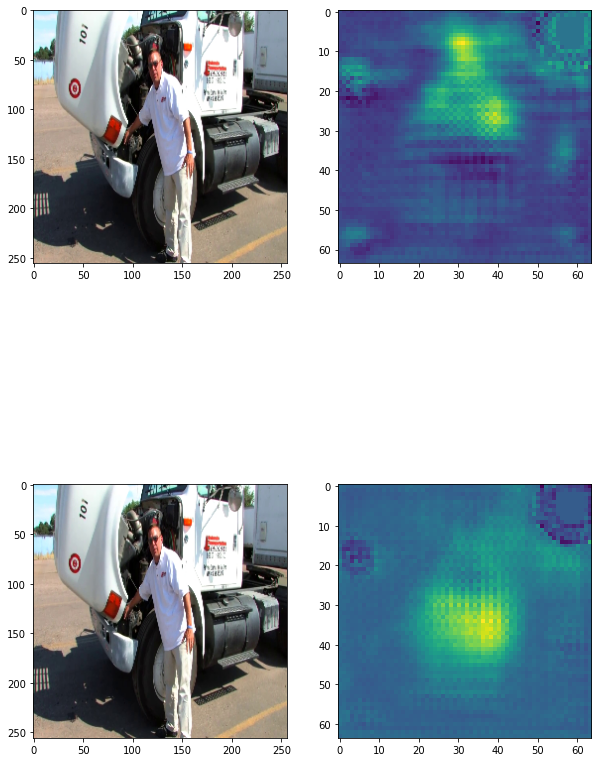


PCK@0.5: {'r ankle': 23.49869451697128, 'r knee': 22.878625134264233, 'r hip': 33.850129198966414, 'l hip': 25.601374570446733, 'l knee': 16.791443850267378, 'l ankle': 19.300518134715023, 'pelvis': 39.325842696629216, 'thorax': 66.02348993288591, 'upper neck': 67.36577181208054, 'head top': 56.45973154362416, 'r wrist': 14.562289562289562, 'r elbow': 15.564853556485355, 'r shoulder': 34.25460636515913, 'l shoulder': 27.341137123745817, 'l elbow': 11.828859060402683, 'l wrist': 15.5668358714044}
Train Loss on epoch 16: 0.001693231743031546
Val Loss on epoch 16: 0.0027559275141633725


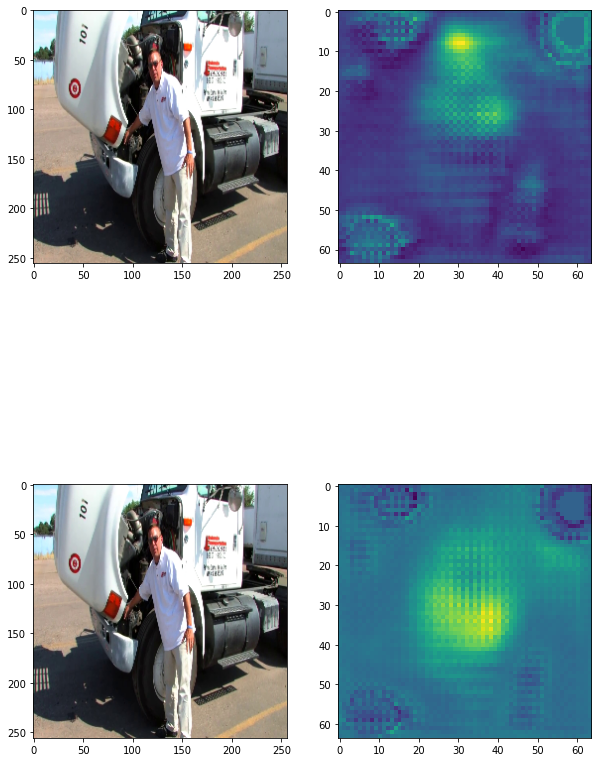


PCK@0.5: {'r ankle': 24.54308093994778, 'r knee': 22.234156820622985, 'r hip': 35.228251507321275, 'l hip': 27.233676975945016, 'l knee': 18.502673796791445, 'l ankle': 20.33678756476684, 'pelvis': 41.83232497839239, 'thorax': 68.8758389261745, 'upper neck': 70.80536912751678, 'head top': 58.38926174496645, 'r wrist': 17.929292929292927, 'r elbow': 18.326359832635983, 'r shoulder': 35.76214405360134, 'l shoulder': 27.759197324414714, 'l elbow': 12.164429530201343, 'l wrist': 15.651438240270727}
Train Loss on epoch 17: 0.0016649054818908158
Val Loss on epoch 17: 0.0027689846009825883


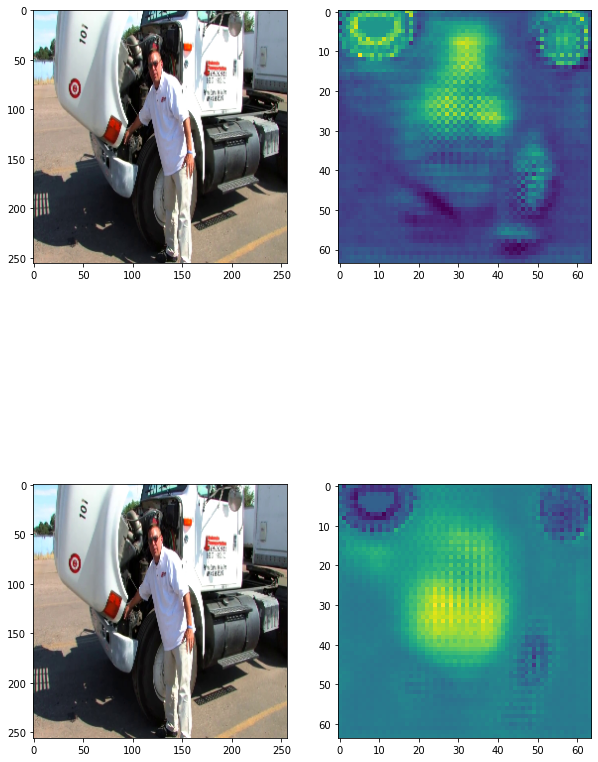


PCK@0.5: {'r ankle': 28.459530026109658, 'r knee': 24.489795918367346, 'r hip': 37.123169681309214, 'l hip': 29.12371134020619, 'l knee': 21.92513368983957, 'l ankle': 22.150259067357513, 'pelvis': 43.99308556611927, 'thorax': 68.79194630872483, 'upper neck': 71.56040268456377, 'head top': 60.06711409395973, 'r wrist': 17.255892255892256, 'r elbow': 20.0, 'r shoulder': 38.107202680067005, 'l shoulder': 27.257525083612038, 'l elbow': 13.590604026845638, 'l wrist': 18.02030456852792}
Train Loss on epoch 18: 0.001639048127538484
Val Loss on epoch 18: 0.002796300656526633


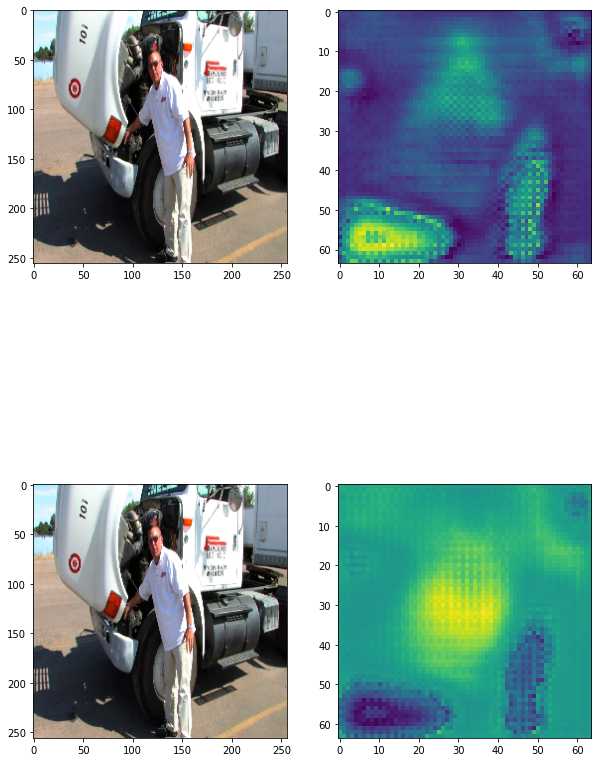


PCK@0.5: {'r ankle': 27.284595300261095, 'r knee': 25.99355531686359, 'r hip': 37.98449612403101, 'l hip': 32.38831615120275, 'l knee': 23.636363636363637, 'l ankle': 22.409326424870464, 'pelvis': 44.9438202247191, 'thorax': 70.38590604026845, 'upper neck': 71.81208053691275, 'head top': 60.23489932885906, 'r wrist': 17.424242424242426, 'r elbow': 19.07949790794979, 'r shoulder': 37.68844221105528, 'l shoulder': 28.093645484949832, 'l elbow': 13.842281879194632, 'l wrist': 19.627749576988155}
Train Loss on epoch 19: 0.0016176303140009226
Val Loss on epoch 19: 0.002790335059651862


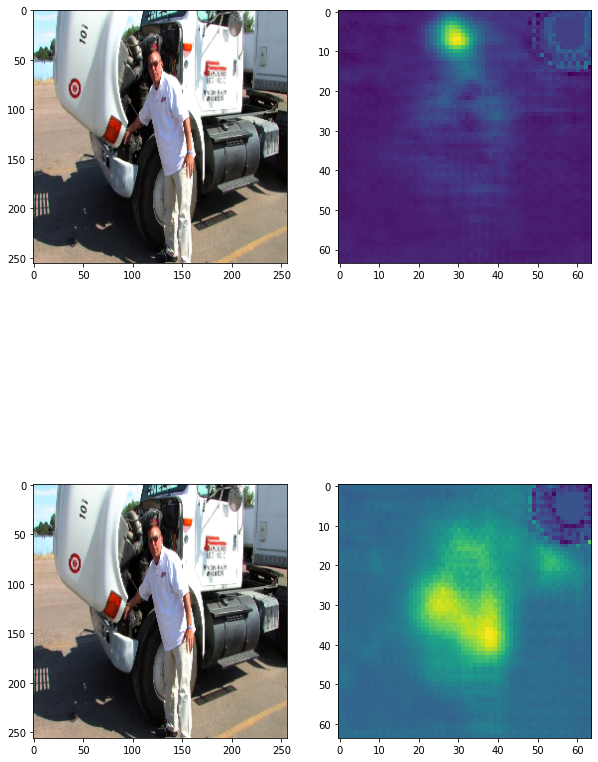


PCK@0.5: {'r ankle': 27.415143603133156, 'r knee': 26.96025778732546, 'r hip': 39.62101636520241, 'l hip': 32.13058419243986, 'l knee': 21.06951871657754, 'l ankle': 19.170984455958546, 'pelvis': 47.36387208297321, 'thorax': 70.55369127516778, 'upper neck': 72.14765100671141, 'head top': 62.08053691275168, 'r wrist': 18.265993265993266, 'r elbow': 18.577405857740587, 'r shoulder': 38.44221105527638, 'l shoulder': 26.08695652173913, 'l elbow': 14.177852348993289, 'l wrist': 18.697123519458543}
Train Loss on epoch 20: 0.001594863813775389
Val Loss on epoch 20: 0.002674858789364605


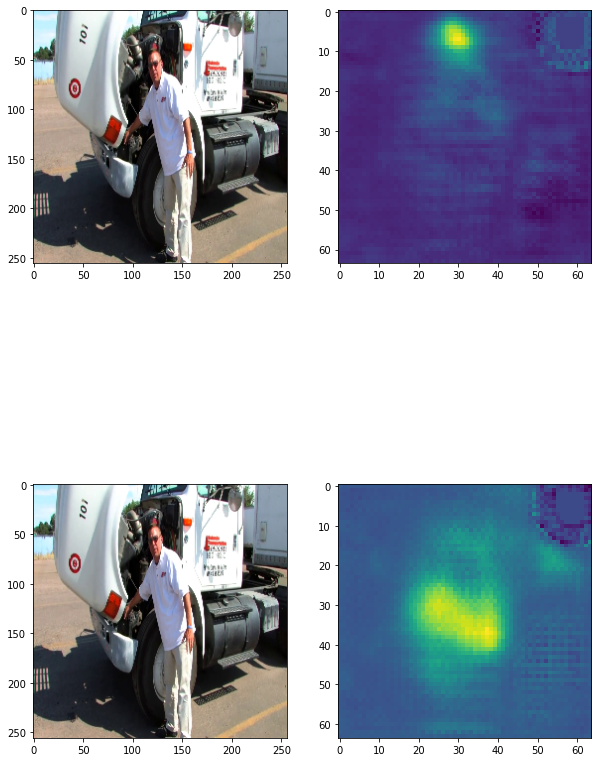


PCK@0.5: {'r ankle': 27.023498694516974, 'r knee': 27.926960257787325, 'r hip': 39.44875107665805, 'l hip': 32.90378006872852, 'l knee': 24.171122994652407, 'l ankle': 23.963730569948186, 'pelvis': 48.31460674157304, 'thorax': 71.64429530201343, 'upper neck': 73.40604026845638, 'head top': 63.171140939597315, 'r wrist': 17.50841750841751, 'r elbow': 19.665271966527197, 'r shoulder': 38.860971524288104, 'l shoulder': 26.00334448160535, 'l elbow': 15.939597315436242, 'l wrist': 21.065989847715734}
Train Loss on epoch 21: 0.0015792020505456172
Val Loss on epoch 21: 0.0026608862377622204


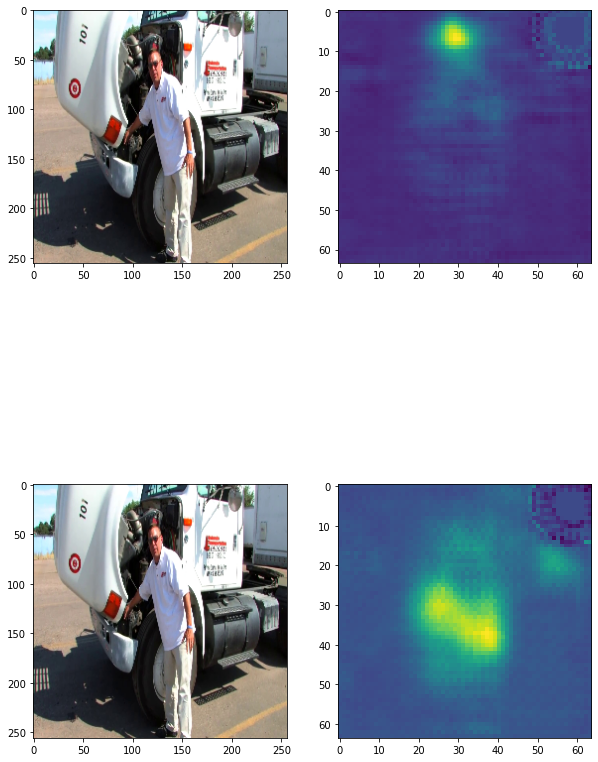


PCK@0.5: {'r ankle': 28.198433420365536, 'r knee': 27.712137486573578, 'r hip': 39.01808785529715, 'l hip': 34.02061855670103, 'l knee': 23.101604278074866, 'l ankle': 22.66839378238342, 'pelvis': 48.48746758859118, 'thorax': 71.97986577181209, 'upper neck': 74.41275167785236, 'head top': 63.42281879194631, 'r wrist': 18.602693602693606, 'r elbow': 19.497907949790793, 'r shoulder': 37.85594639865997, 'l shoulder': 29.09698996655518, 'l elbow': 16.023489932885905, 'l wrist': 22.165820642978005}
Train Loss on epoch 22: 0.0015607501015714978
Val Loss on epoch 22: 0.002743365364554136


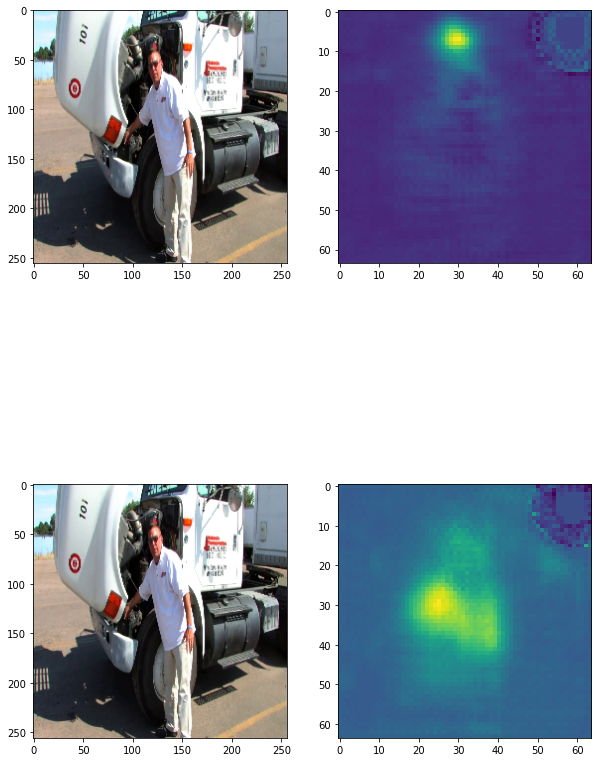


PCK@0.5: {'r ankle': 28.98172323759791, 'r knee': 27.38990332975295, 'r hip': 42.29112833763997, 'l hip': 32.90378006872852, 'l knee': 22.032085561497325, 'l ankle': 23.83419689119171, 'pelvis': 50.388936905790835, 'thorax': 72.98657718120806, 'upper neck': 74.66442953020133, 'head top': 64.34563758389261, 'r wrist': 19.107744107744107, 'r elbow': 21.422594142259413, 'r shoulder': 45.22613065326633, 'l shoulder': 28.17725752508361, 'l elbow': 16.69463087248322, 'l wrist': 21.658206429780034}
Train Loss on epoch 23: 0.001540289798994427
Val Loss on epoch 23: 0.00271629161991017


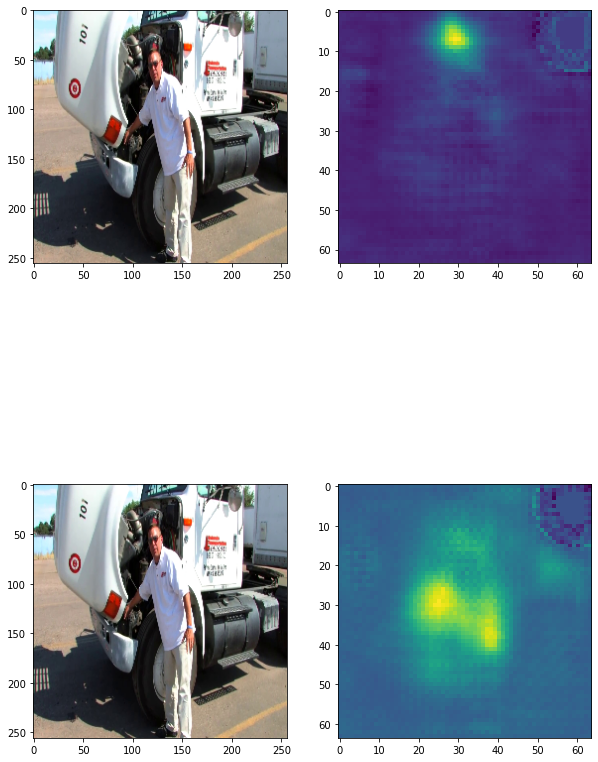


PCK@0.5: {'r ankle': 30.548302872062667, 'r knee': 29.860365198711065, 'r hip': 43.41085271317829, 'l hip': 34.62199312714777, 'l knee': 24.49197860962567, 'l ankle': 23.44559585492228, 'pelvis': 51.68539325842697, 'thorax': 73.90939597315436, 'upper neck': 75.92281879194631, 'head top': 64.51342281879194, 'r wrist': 21.21212121212121, 'r elbow': 22.845188284518827, 'r shoulder': 40.871021775544385, 'l shoulder': 31.521739130434785, 'l elbow': 18.959731543624162, 'l wrist': 21.82741116751269}
Train Loss on epoch 24: 0.0015268270705786088
Val Loss on epoch 24: 0.002661940383562899


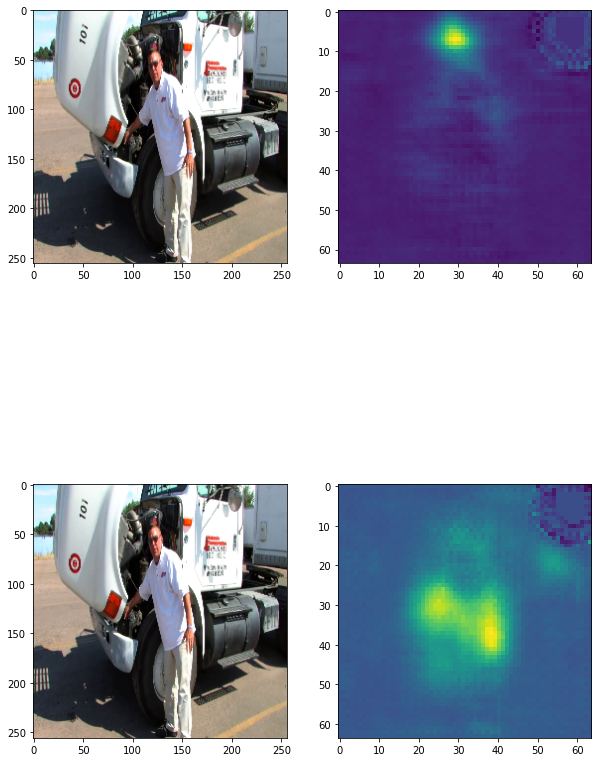


PCK@0.5: {'r ankle': 31.98433420365535, 'r knee': 29.430719656283564, 'r hip': 39.96554694229113, 'l hip': 36.68384879725085, 'l knee': 24.27807486631016, 'l ankle': 24.740932642487046, 'pelvis': 50.648228176318064, 'thorax': 74.49664429530202, 'upper neck': 76.59395973154362, 'head top': 65.93959731543623, 'r wrist': 20.2020202020202, 'r elbow': 21.506276150627617, 'r shoulder': 43.04857621440536, 'l shoulder': 28.34448160535117, 'l elbow': 18.959731543624162, 'l wrist': 21.99661590524535}
Train Loss on epoch 25: 0.0015104902675375342
Val Loss on epoch 25: 0.002580630846078629


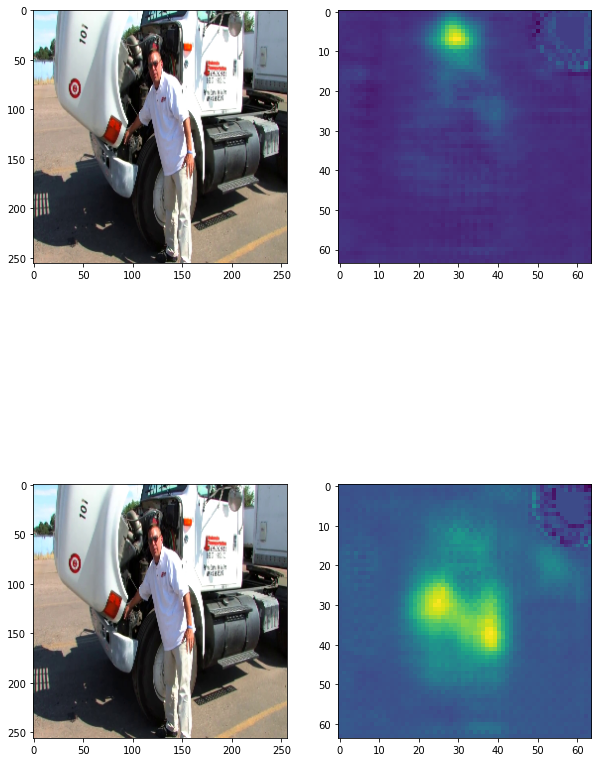


PCK@0.5: {'r ankle': 30.809399477806785, 'r knee': 29.32330827067669, 'r hip': 42.29112833763997, 'l hip': 36.51202749140893, 'l knee': 25.3475935828877, 'l ankle': 25.0, 'pelvis': 51.51253241140882, 'thorax': 74.91610738255034, 'upper neck': 75.50335570469798, 'head top': 66.2751677852349, 'r wrist': 21.96969696969697, 'r elbow': 23.09623430962343, 'r shoulder': 43.04857621440536, 'l shoulder': 30.85284280936455, 'l elbow': 19.546979865771814, 'l wrist': 21.658206429780034}
Train Loss on epoch 26: 0.0014987909508383144
Val Loss on epoch 26: 0.0026464623540801845


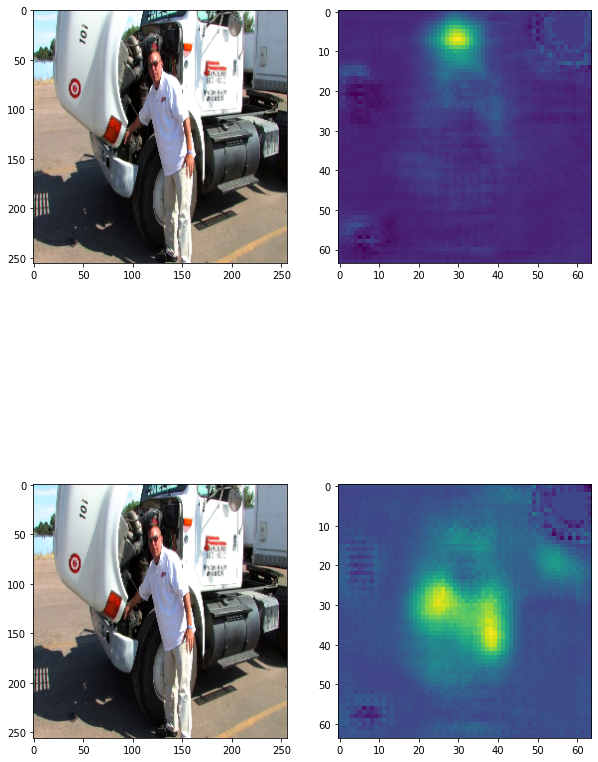


PCK@0.5: {'r ankle': 31.723237597911226, 'r knee': 30.50483351235231, 'r hip': 45.13350559862187, 'l hip': 34.87972508591065, 'l knee': 25.454545454545453, 'l ankle': 24.22279792746114, 'pelvis': 52.98184961106309, 'thorax': 75.08389261744966, 'upper neck': 75.58724832214764, 'head top': 65.35234899328859, 'r wrist': 20.707070707070706, 'r elbow': 23.347280334728033, 'r shoulder': 47.31993299832496, 'l shoulder': 28.17725752508361, 'l elbow': 19.88255033557047, 'l wrist': 22.33502538071066}
Train Loss on epoch 27: 0.0014836884336546063
Val Loss on epoch 27: 0.002538133260753492


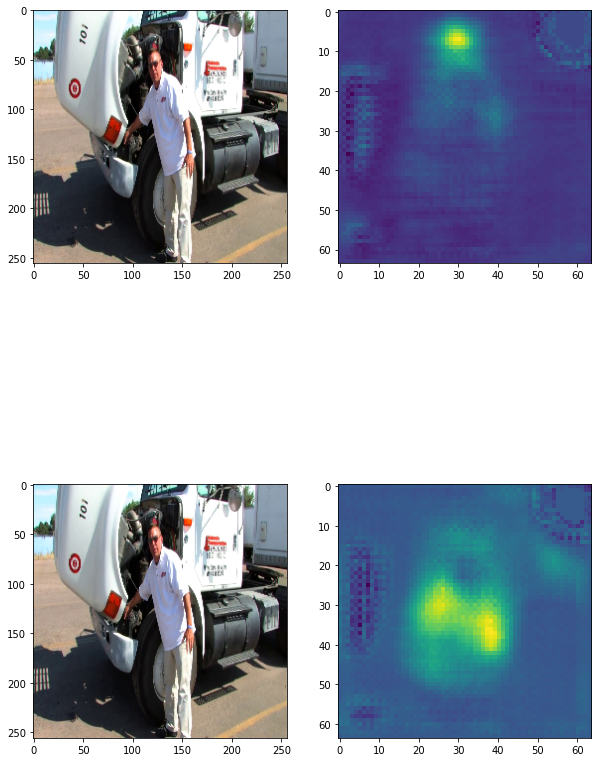


PCK@0.5: {'r ankle': 30.93994778067885, 'r knee': 28.678839957035446, 'r hip': 45.73643410852713, 'l hip': 36.08247422680412, 'l knee': 26.203208556149733, 'l ankle': 23.704663212435236, 'pelvis': 55.142610198789974, 'thorax': 76.00671140939598, 'upper neck': 76.84563758389261, 'head top': 67.11409395973155, 'r wrist': 22.81144781144781, 'r elbow': 22.761506276150627, 'r shoulder': 46.06365159128978, 'l shoulder': 30.351170568561876, 'l elbow': 20.889261744966444, 'l wrist': 22.419627749576986}
Train Loss on epoch 28: 0.0014710921814422245
Val Loss on epoch 28: 0.002619190354143148


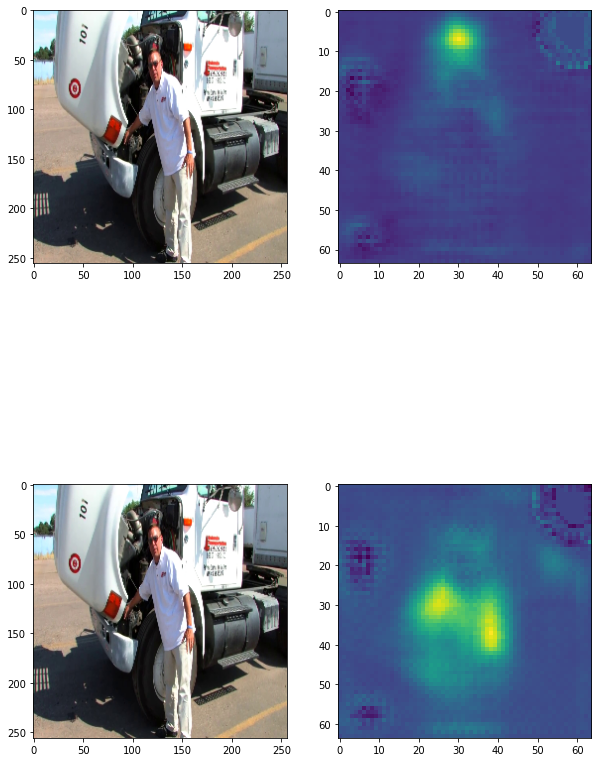

In [ ]:
train(train_loader, model, criterion, optimizer, 30, val_dataset[4][0], sheduler, val_loader, regr=True)

In [ ]:
validate_search(model, val_loader, np.linspace(0.5, 0.7, 50))

In [ ]:
val_img = val_dataset[4][0]

In [ ]:
with torch.no_grad():
    pred = model(val_img.unsqueeze(0).to(device))
    fig, ax = plt.subplots(1, 2, figsize=(10, 16))
    ax[0].imshow((val_img * 0.3 + 0.3).permute(1, 2, 0).numpy())
    ax[1].imshow(pred[0][9].cpu().detach().numpy())
    plt.show()

In [ ]:
with torch.no_grad():
    pred = model(val_img.unsqueeze(0).to(device))
    fig, ax = plt.subplots(1, 2, figsize=(10, 16))
    ax[0].imshow((val_img * 0.3 + 0.3).permute(1, 2, 0).numpy())
    ax[1].imshow(pred[0][1].cpu().detach().numpy())
    plt.show()

In [ ]:
with torch.no_grad():
    pred = model(val_img.unsqueeze(0).to(device))
    fig, ax = plt.subplots(1, 2, figsize=(10, 16))
    ax[0].imshow((val_img * 0.3 + 0.3).permute(1, 2, 0).numpy())
    ax[1].imshow(pred[0][4].cpu().detach().numpy())
    plt.show()

In [ ]:
with torch.no_grad():
    pred = model(val_img.unsqueeze(0).to(device))
    fig, ax = plt.subplots(1, 2, figsize=(10, 16))
    ax[0].imshow((val_img * 0.3 + 0.3).permute(1, 2, 0).numpy())
    ax[1].imshow(pred[0][10].cpu().detach().numpy())
    plt.show()

In [ ]:
with torch.no_grad():
    pred = model(val_img.unsqueeze(0).to(device))
    fig, ax = plt.subplots(1, 2, figsize=(10, 16))
    ax[0].imshow((val_img * 0.3 + 0.3).permute(1, 2, 0).numpy())
    ax[1].imshow(pred[0][15].cpu().detach().numpy())
    plt.show()

# Cross-entropy

In [ ]:
train_loader = torch.utils.data.DataLoader(train_dataset,
                                           shuffle=True,
                                           batch_size=64,
                                           num_workers=2)

val_loader = torch.utils.data.DataLoader(val_dataset,
                                           shuffle=False,
                                           batch_size=64,
                                           num_workers=2)
model = SGSK(17).to(device)
criterion = Custom_Loss('cross_entropy')
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
sheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, 0.9)


PCK@0.5: {'r ankle': 22.193211488250654, 'r knee': 20.193340494092375, 'r hip': 20.671834625322997, 'l hip': 20.790378006872853, 'l knee': 18.71657754010695, 'l ankle': 19.818652849740932, 'pelvis': 31.20138288677615, 'thorax': 57.130872483221474, 'upper neck': 52.60067114093959, 'head top': 47.23154362416108, 'r wrist': 19.78114478114478, 'r elbow': 15.899581589958158, 'r shoulder': 26.800670016750416, 'l shoulder': 28.846153846153843, 'l elbow': 11.493288590604028, 'l wrist': 20.473773265651438}
Train Loss on epoch 1: 37.22246610392695
Val Loss on epoch 1: 32.59068226284451


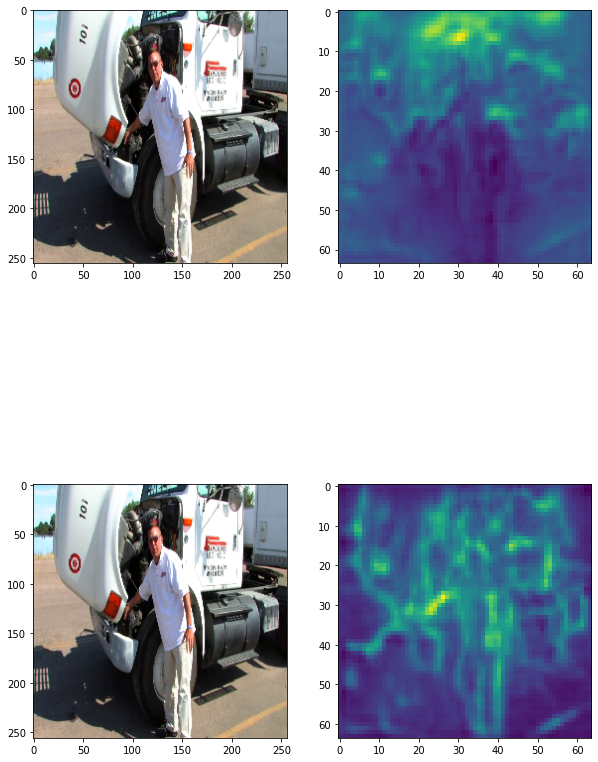


PCK@0.5: {'r ankle': 22.715404699738905, 'r knee': 22.986036519871107, 'r hip': 25.32299741602067, 'l hip': 22.68041237113402, 'l knee': 15.294117647058824, 'l ankle': 20.077720207253886, 'pelvis': 44.2523768366465, 'thorax': 66.02348993288591, 'upper neck': 63.674496644295296, 'head top': 55.788590604026844, 'r wrist': 23.82154882154882, 'r elbow': 18.15899581589958, 'r shoulder': 24.706867671691793, 'l shoulder': 19.648829431438127, 'l elbow': 16.359060402684563, 'l wrist': 23.77326565143824}
Train Loss on epoch 2: 31.111224414991295
Val Loss on epoch 2: 29.472423723008898


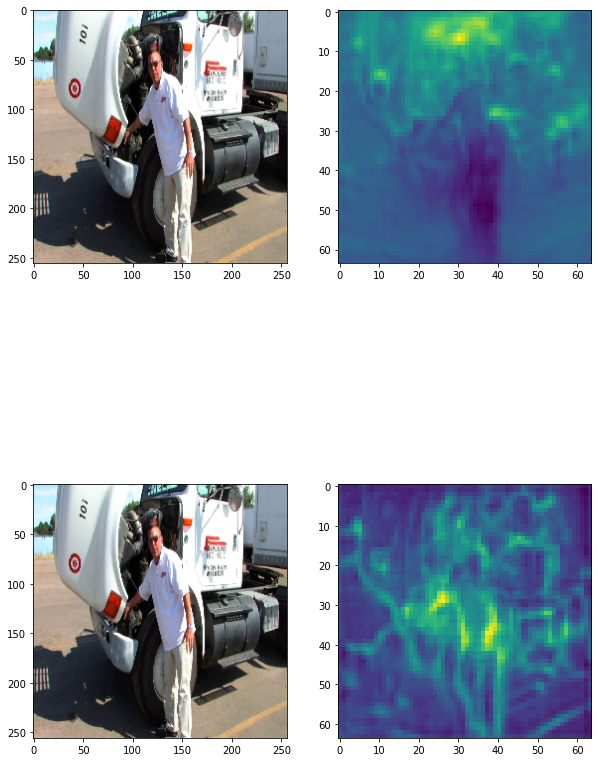


PCK@0.5: {'r ankle': 25.06527415143603, 'r knee': 24.167561761546725, 'r hip': 31.61068044788975, 'l hip': 32.13058419243986, 'l knee': 23.422459893048128, 'l ankle': 23.186528497409327, 'pelvis': 51.42610198789974, 'thorax': 71.97986577181209, 'upper neck': 65.77181208053692, 'head top': 59.312080536912745, 'r wrist': 27.525252525252526, 'r elbow': 21.92468619246862, 'r shoulder': 26.298157453936348, 'l shoulder': 27.591973244147155, 'l elbow': 28.523489932885905, 'l wrist': 28.76480541455161}
Train Loss on epoch 3: 28.4232386879299
Val Loss on epoch 3: 27.581685129801432


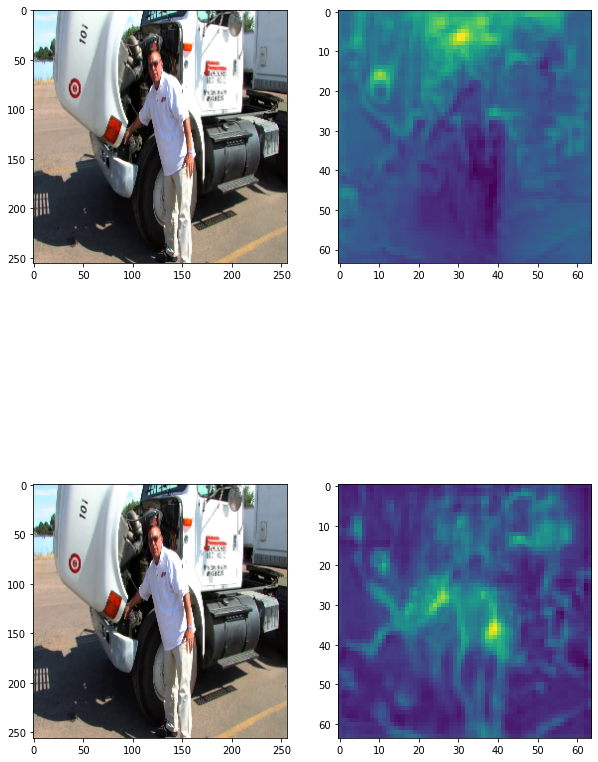


PCK@0.5: {'r ankle': 26.240208877284594, 'r knee': 27.06766917293233, 'r hip': 30.40482342807924, 'l hip': 39.60481099656357, 'l knee': 26.09625668449198, 'l ankle': 26.42487046632124, 'pelvis': 52.89541918755402, 'thorax': 73.07046979865773, 'upper neck': 70.55369127516778, 'head top': 61.91275167785235, 'r wrist': 28.28282828282828, 'r elbow': 31.548117154811717, 'r shoulder': 42.54606365159129, 'l shoulder': 38.12709030100335, 'l elbow': 32.5503355704698, 'l wrist': 28.680203045685282}
Train Loss on epoch 4: 26.703737715016242
Val Loss on epoch 4: 26.314453252156575


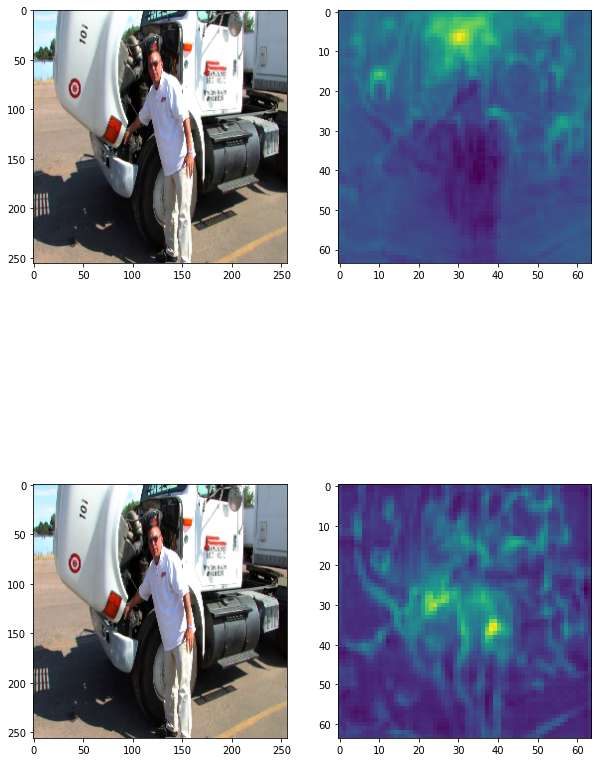


PCK@0.5: {'r ankle': 28.198433420365536, 'r knee': 29.860365198711065, 'r hip': 38.67355727820844, 'l hip': 38.91752577319588, 'l knee': 30.267379679144383, 'l ankle': 27.72020725388601, 'pelvis': 57.21694036300777, 'thorax': 76.51006711409396, 'upper neck': 74.91610738255034, 'head top': 65.68791946308725, 'r wrist': 29.46127946127946, 'r elbow': 26.861924686192467, 'r shoulder': 41.87604690117253, 'l shoulder': 42.30769230769231, 'l elbow': 25.335570469798657, 'l wrist': 33.079526226734345}
Train Loss on epoch 5: 25.379784948929498
Val Loss on epoch 5: 25.480707338121203


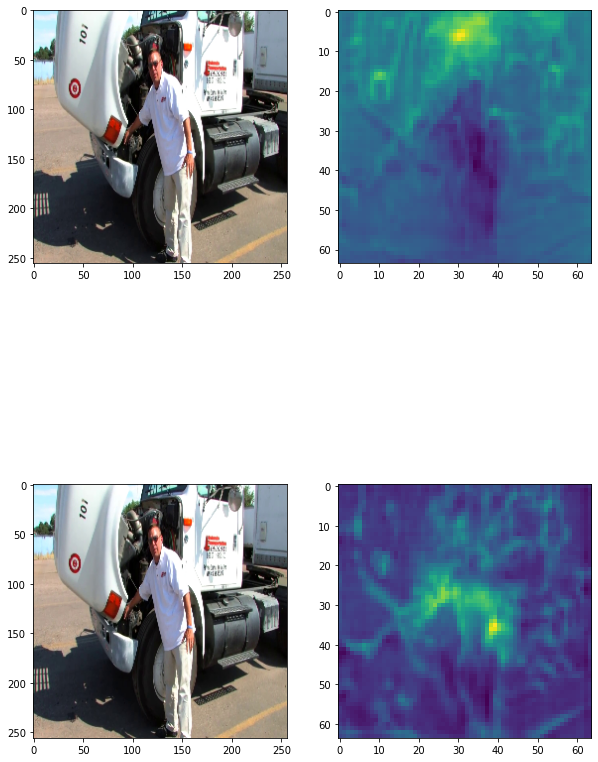


PCK@0.5: {'r ankle': 30.287206266318538, 'r knee': 27.926960257787325, 'r hip': 42.377260981912144, 'l hip': 41.66666666666667, 'l knee': 31.65775401069519, 'l ankle': 26.03626943005181, 'pelvis': 61.79775280898876, 'thorax': 78.94295302013423, 'upper neck': 75.75503355704699, 'head top': 66.2751677852349, 'r wrist': 34.25925925925926, 'r elbow': 31.88284518828452, 'r shoulder': 59.12897822445561, 'l shoulder': 50.08361204013379, 'l elbow': 31.79530201342282, 'l wrist': 32.99492385786802}
Train Loss on epoch 6: 24.454615228072456
Val Loss on epoch 6: 24.800289323594836


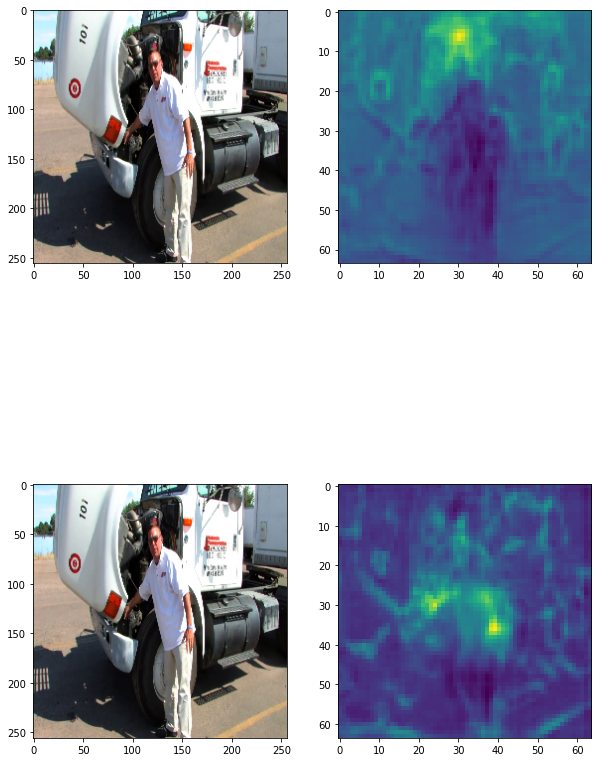


PCK@0.5: {'r ankle': 31.853785900783286, 'r knee': 28.4640171858217, 'r hip': 46.51162790697674, 'l hip': 36.42611683848797, 'l knee': 32.0855614973262, 'l ankle': 29.404145077720205, 'pelvis': 62.31633535004322, 'thorax': 79.11073825503355, 'upper neck': 79.9496644295302, 'head top': 69.29530201342283, 'r wrist': 32.744107744107744, 'r elbow': 29.20502092050209, 'r shoulder': 47.571189279731996, 'l shoulder': 33.27759197324415, 'l elbow': 26.34228187919463, 'l wrist': 31.89509306260575}
Train Loss on epoch 7: 23.634478651958965
Val Loss on epoch 7: 24.2615966796875


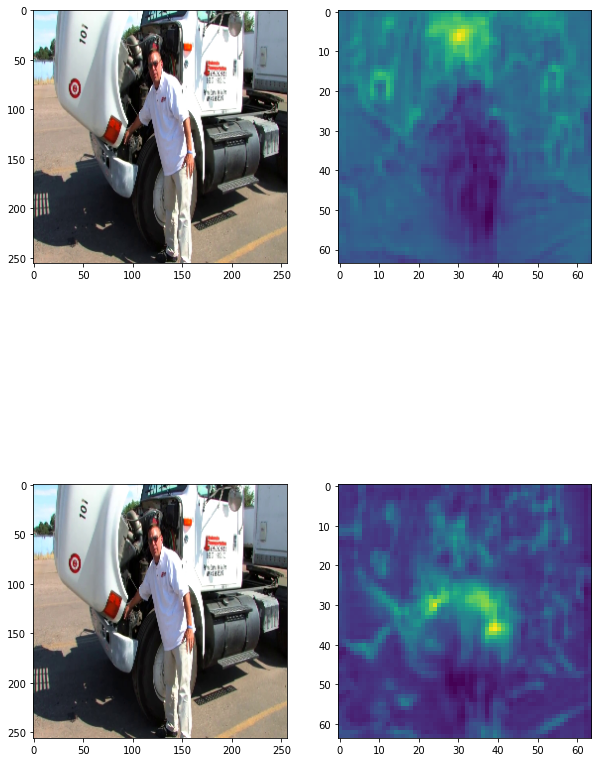


PCK@0.5: {'r ankle': 33.02872062663185, 'r knee': 26.423200859291086, 'r hip': 36.52024117140396, 'l hip': 43.6426116838488, 'l knee': 27.379679144385026, 'l ankle': 28.367875647668395, 'pelvis': 63.87208297320657, 'thorax': 80.28523489932886, 'upper neck': 80.11744966442953, 'head top': 69.71476510067114, 'r wrist': 31.48148148148148, 'r elbow': 31.799163179916317, 'r shoulder': 49.66499162479062, 'l shoulder': 38.7123745819398, 'l elbow': 29.36241610738255, 'l wrist': 35.95600676818951}
Train Loss on epoch 8: 22.963938389653745
Val Loss on epoch 8: 24.06406127081977


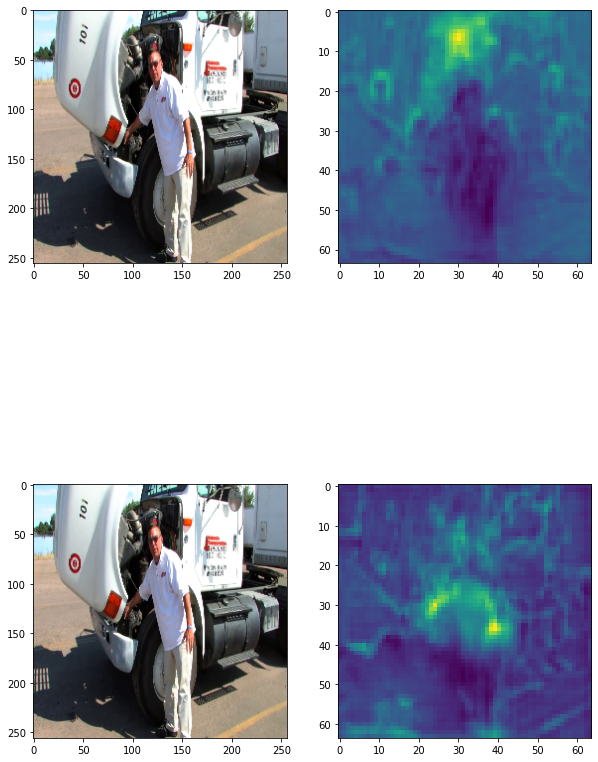


PCK@0.5: {'r ankle': 29.112271540469976, 'r knee': 30.82706766917293, 'r hip': 43.669250645994836, 'l hip': 34.36426116838488, 'l knee': 33.155080213903744, 'l ankle': 29.14507772020725, 'pelvis': 65.68712186689714, 'thorax': 81.29194630872483, 'upper neck': 81.3758389261745, 'head top': 71.72818791946308, 'r wrist': 34.84848484848485, 'r elbow': 30.627615062761503, 'r shoulder': 41.20603015075377, 'l shoulder': 39.63210702341137, 'l elbow': 27.936241610738254, 'l wrist': 35.6175972927242}
Train Loss on epoch 9: 22.403842544555665
Val Loss on epoch 9: 23.701328616672093


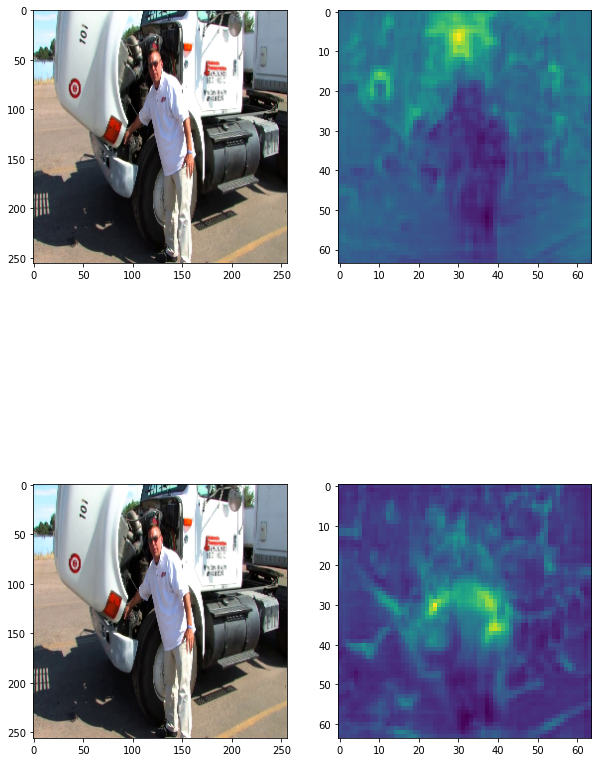


PCK@0.5: {'r ankle': 33.68146214099217, 'r knee': 33.08270676691729, 'r hip': 36.95090439276486, 'l hip': 31.529209621993125, 'l knee': 31.550802139037433, 'l ankle': 29.792746113989637, 'pelvis': 68.53932584269663, 'thorax': 82.71812080536914, 'upper neck': 82.21476510067114, 'head top': 72.81879194630872, 'r wrist': 35.43771043771044, 'r elbow': 30.125523012552303, 'r shoulder': 41.45728643216081, 'l shoulder': 27.508361204013376, 'l elbow': 31.711409395973156, 'l wrist': 32.48730964467005}
Train Loss on epoch 10: 21.873462834565537
Val Loss on epoch 10: 23.481125937567818


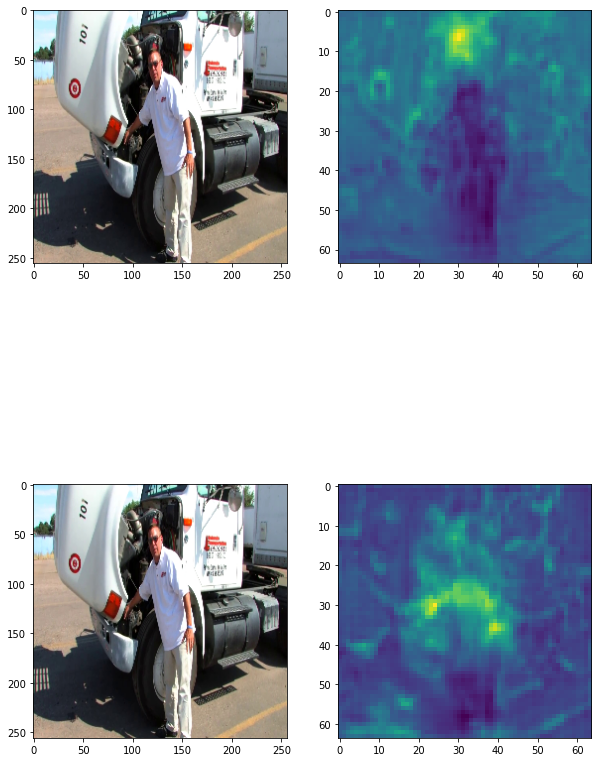


PCK@0.5: {'r ankle': 33.81201044386423, 'r knee': 32.00859291084855, 'r hip': 47.88975021533161, 'l hip': 37.97250859106529, 'l knee': 28.235294117647058, 'l ankle': 29.66321243523316, 'pelvis': 67.32929991356957, 'thorax': 83.89261744966443, 'upper neck': 82.21476510067114, 'head top': 73.90939597315436, 'r wrist': 32.996632996633, 'r elbow': 24.93723849372385, 'r shoulder': 60.13400335008375, 'l shoulder': 48.99665551839465, 'l elbow': 29.36241610738255, 'l wrist': 35.025380710659896}
Train Loss on epoch 11: 21.379892481928287
Val Loss on epoch 11: 23.165137354532877


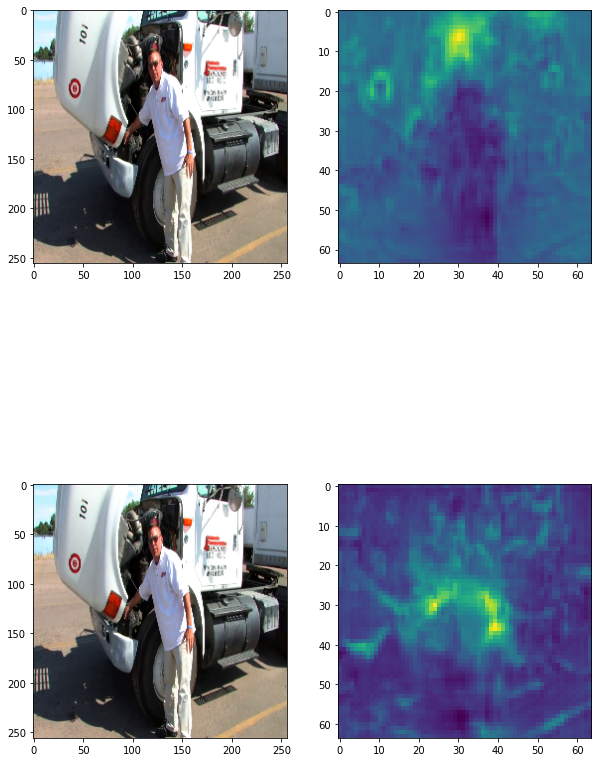


PCK@0.5: {'r ankle': 34.9869451697128, 'r knee': 31.793770139634802, 'r hip': 39.70714900947459, 'l hip': 33.50515463917525, 'l knee': 29.62566844919786, 'l ankle': 25.906735751295333, 'pelvis': 67.5885911840968, 'thorax': 85.8221476510067, 'upper neck': 83.22147651006712, 'head top': 75.25167785234899, 'r wrist': 34.090909090909086, 'r elbow': 29.288702928870293, 'r shoulder': 33.24958123953099, 'l shoulder': 39.46488294314381, 'l elbow': 24.664429530201343, 'l wrist': 34.09475465313029}
Train Loss on epoch 12: 20.9512195089589
Val Loss on epoch 12: 23.106038920084636


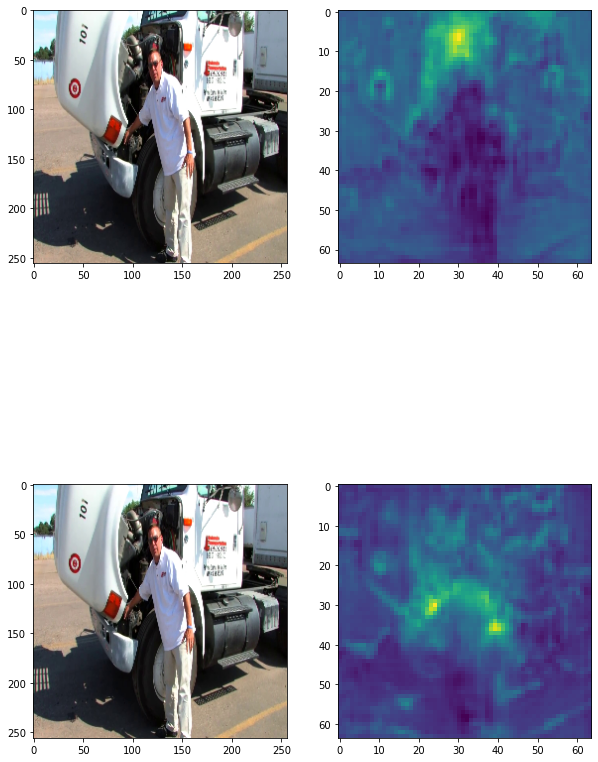


PCK@0.5: {'r ankle': 34.46475195822455, 'r knee': 34.58646616541353, 'r hip': 38.67355727820844, 'l hip': 34.106529209621996, 'l knee': 30.053475935828878, 'l ankle': 29.533678756476682, 'pelvis': 70.70008643042351, 'thorax': 84.47986577181209, 'upper neck': 84.47986577181209, 'head top': 76.00671140939598, 'r wrist': 36.784511784511785, 'r elbow': 32.63598326359833, 'r shoulder': 51.005025125628144, 'l shoulder': 43.72909698996656, 'l elbow': 33.053691275167786, 'l wrist': 35.87140439932318}
Train Loss on epoch 13: 20.60335174228834
Val Loss on epoch 13: 23.038677554660374


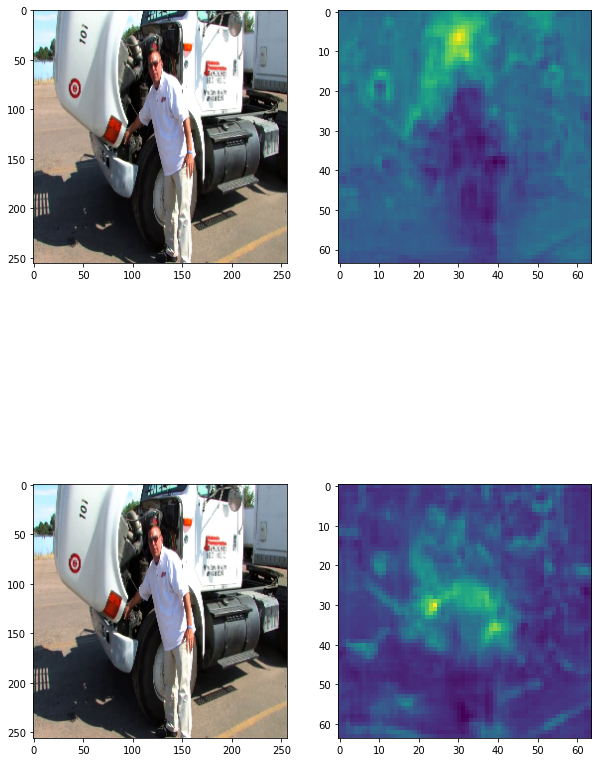


PCK@0.5: {'r ankle': 34.595300261096604, 'r knee': 36.51987110633727, 'r hip': 40.482342807924205, 'l hip': 37.628865979381445, 'l knee': 30.58823529411765, 'l ankle': 27.072538860103627, 'pelvis': 70.70008643042351, 'thorax': 84.73154362416108, 'upper neck': 84.73154362416108, 'head top': 75.67114093959731, 'r wrist': 35.26936026936027, 'r elbow': 28.451882845188287, 'r shoulder': 41.79229480737018, 'l shoulder': 32.19063545150502, 'l elbow': 30.285234899328863, 'l wrist': 34.85617597292725}
Train Loss on epoch 14: 20.25097181071406
Val Loss on epoch 14: 22.726241005791557


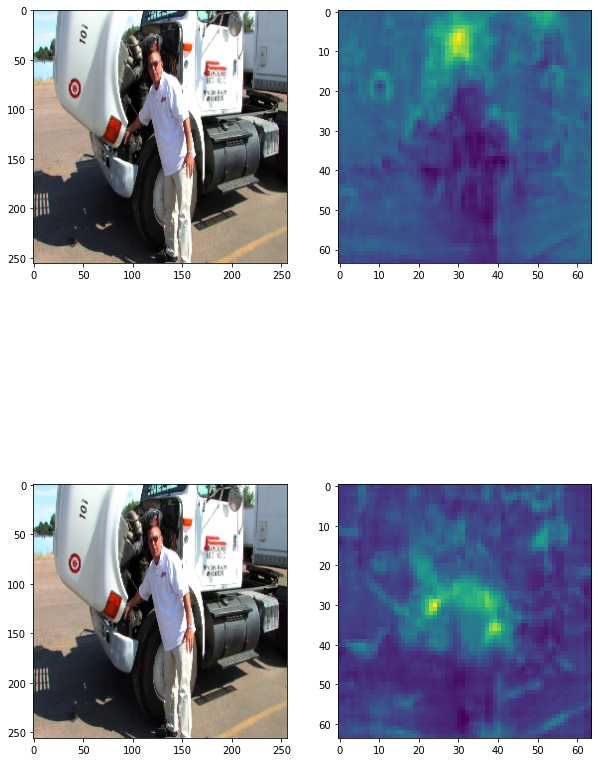


PCK@0.5: {'r ankle': 33.81201044386423, 'r knee': 36.19763694951665, 'r hip': 37.72609819121447, 'l hip': 31.443298969072163, 'l knee': 26.09625668449198, 'l ankle': 26.55440414507772, 'pelvis': 70.78651685393258, 'thorax': 85.73825503355704, 'upper neck': 85.40268456375838, 'head top': 74.66442953020133, 'r wrist': 32.82828282828283, 'r elbow': 28.535564853556483, 'r shoulder': 52.01005025125628, 'l shoulder': 29.09698996655518, 'l elbow': 33.053691275167786, 'l wrist': 37.1404399323181}
Train Loss on epoch 15: 19.936005866009257
Val Loss on epoch 15: 22.766061782836914


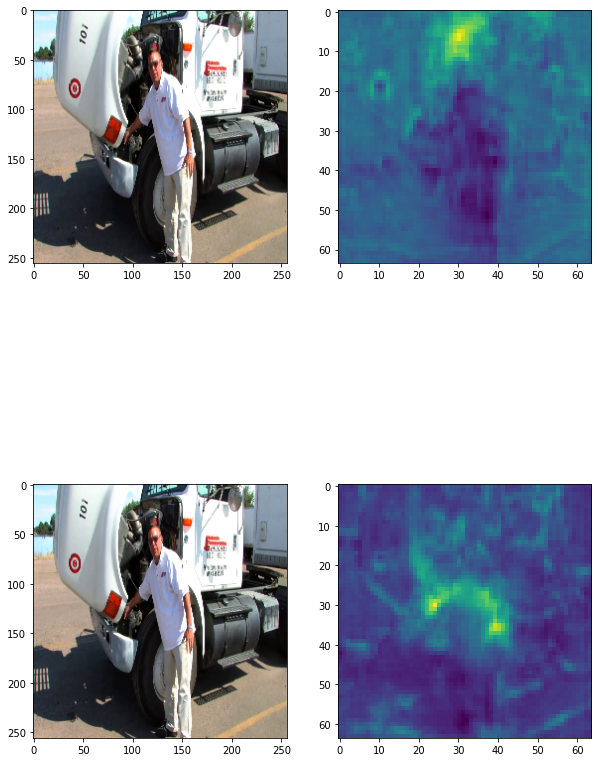


PCK@0.5: {'r ankle': 37.467362924281986, 'r knee': 37.59398496240601, 'r hip': 48.492678725236864, 'l hip': 49.91408934707904, 'l knee': 36.57754010695187, 'l ankle': 32.512953367875646, 'pelvis': 70.61365600691444, 'thorax': 86.24161073825503, 'upper neck': 86.3255033557047, 'head top': 75.50335570469798, 'r wrist': 38.04713804713805, 'r elbow': 31.213389121338913, 'r shoulder': 57.03517587939698, 'l shoulder': 37.54180602006689, 'l elbow': 36.66107382550335, 'l wrist': 39.424703891708965}
Train Loss on epoch 16: 19.6526611328125
Val Loss on epoch 16: 22.669802390204534


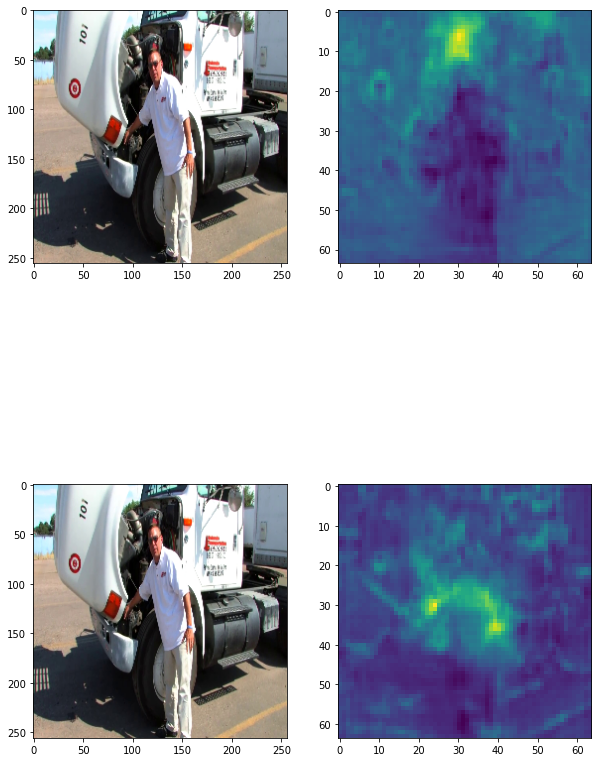


PCK@0.5: {'r ankle': 31.853785900783286, 'r knee': 37.808807733619766, 'r hip': 46.51162790697674, 'l hip': 46.90721649484536, 'l knee': 35.61497326203209, 'l ankle': 30.958549222797927, 'pelvis': 71.91011235955057, 'thorax': 85.90604026845638, 'upper neck': 85.31879194630872, 'head top': 76.51006711409396, 'r wrist': 37.71043771043771, 'r elbow': 36.23430962343096, 'r shoulder': 59.96649916247906, 'l shoulder': 47.9933110367893, 'l elbow': 38.171140939597315, 'l wrist': 38.49407783417936}
Train Loss on epoch 17: 19.366516030353047
Val Loss on epoch 17: 22.4017034318712


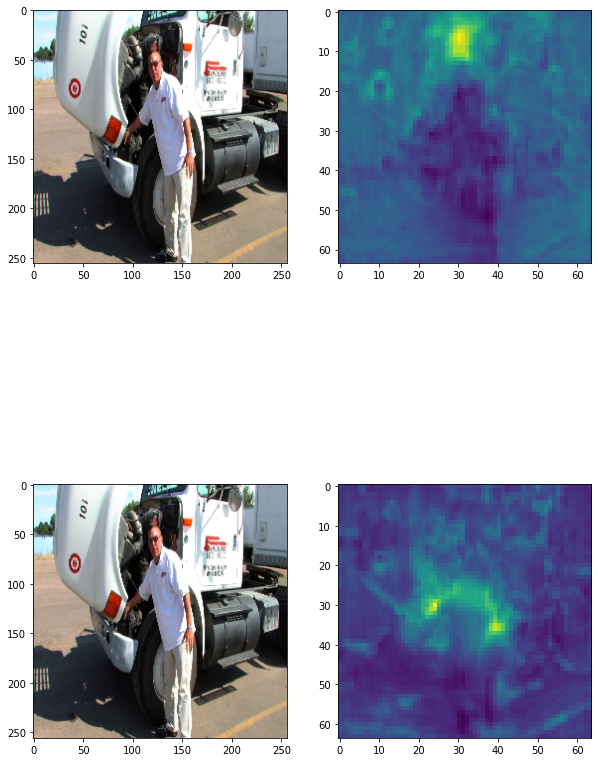


PCK@0.5: {'r ankle': 34.07310704960835, 'r knee': 37.91621911922664, 'r hip': 36.95090439276486, 'l hip': 39.261168384879724, 'l knee': 31.978609625668447, 'l ankle': 34.32642487046632, 'pelvis': 72.60155574762315, 'thorax': 85.90604026845638, 'upper neck': 85.8221476510067, 'head top': 76.25838926174497, 'r wrist': 39.141414141414145, 'r elbow': 33.47280334728033, 'r shoulder': 54.2713567839196, 'l shoulder': 43.31103678929766, 'l elbow': 32.38255033557047, 'l wrist': 33.67174280879864}
Train Loss on epoch 18: 19.142121447687565
Val Loss on epoch 18: 22.72224515279134


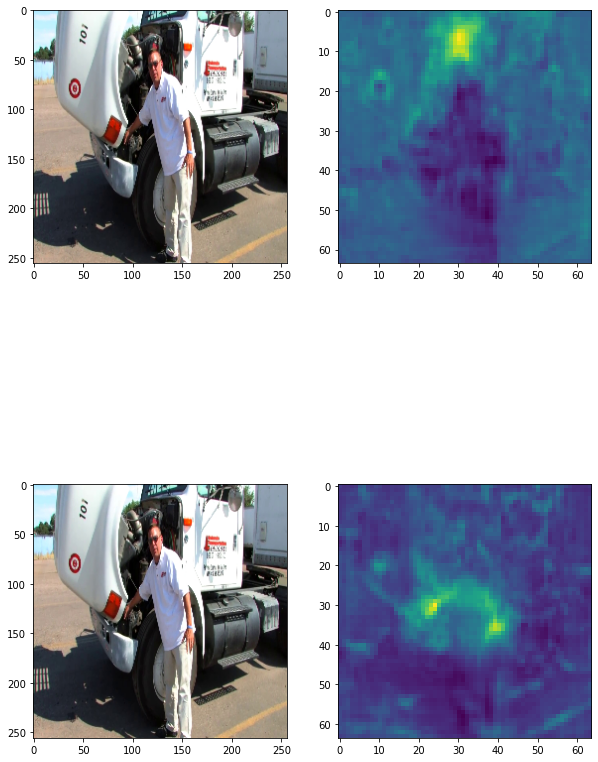


PCK@0.5: {'r ankle': 33.15926892950392, 'r knee': 40.494092373791624, 'r hip': 41.688199827734714, 'l hip': 38.659793814432994, 'l knee': 33.68983957219251, 'l ankle': 30.569948186528496, 'pelvis': 73.29299913569577, 'thorax': 86.0738255033557, 'upper neck': 86.49328859060402, 'head top': 74.91610738255034, 'r wrist': 39.8989898989899, 'r elbow': 33.22175732217573, 'r shoulder': 50.0, 'l shoulder': 39.214046822742475, 'l elbow': 37.24832214765101, 'l wrist': 35.44839255499154}
Train Loss on epoch 19: 18.911618050285007
Val Loss on epoch 19: 22.403007125854494


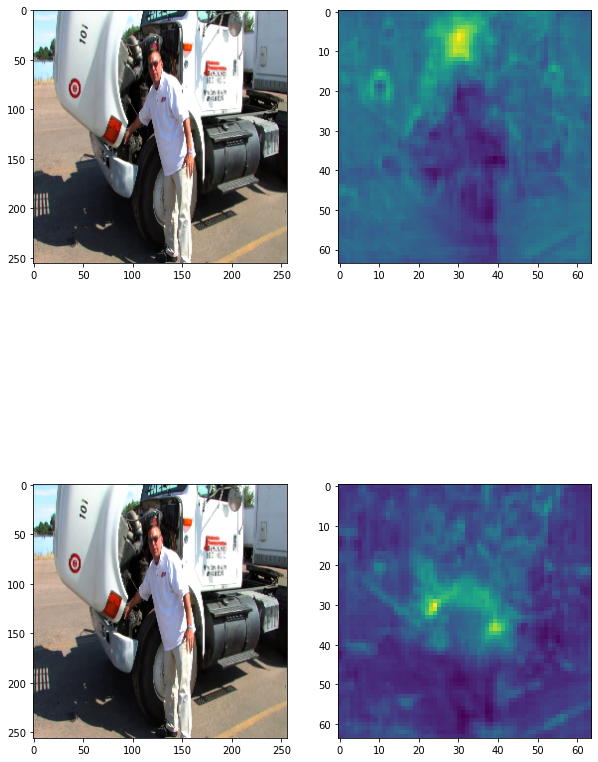


PCK@0.5: {'r ankle': 34.72584856396867, 'r knee': 38.23845327604726, 'r hip': 43.238587424633934, 'l hip': 39.86254295532646, 'l knee': 31.871657754010695, 'l ankle': 30.440414507772022, 'pelvis': 73.2065687121867, 'thorax': 87.24832214765101, 'upper neck': 87.08053691275168, 'head top': 76.84563758389261, 'r wrist': 36.447811447811446, 'r elbow': 31.04602510460251, 'r shoulder': 35.34338358458962, 'l shoulder': 27.424749163879596, 'l elbow': 29.446308724832214, 'l wrist': 36.209813874788495}
Train Loss on epoch 20: 18.74289438828178
Val Loss on epoch 20: 22.7068970574273


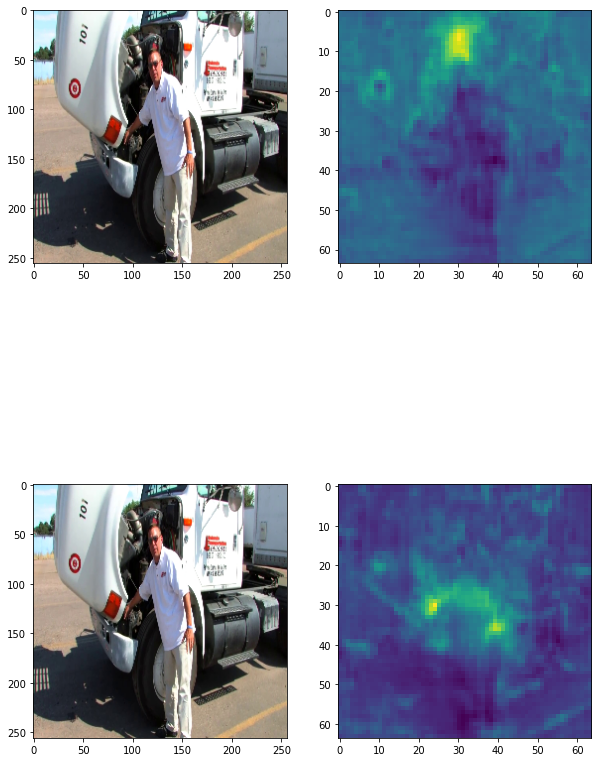

In [ ]:
train(train_loader, model, criterion, optimizer, 20, val_dataset[4][0], sheduler, val_loader)


PCK@0.5: {'r ankle': 33.81201044386423, 'r knee': 37.808807733619766, 'r hip': 41.688199827734714, 'l hip': 34.87972508591065, 'l knee': 35.61497326203209, 'l ankle': 29.66321243523316, 'pelvis': 73.37942955920485, 'thorax': 86.99664429530202, 'upper neck': 86.82885906040269, 'head top': 76.09060402684564, 'r wrist': 37.28956228956229, 'r elbow': 31.548117154811717, 'r shoulder': 49.0787269681742, 'l shoulder': 38.46153846153847, 'l elbow': 33.053691275167786, 'l wrist': 34.940778341793575}
Train Loss on epoch 1: 18.53426918361498
Val Loss on epoch 1: 22.452602767944335


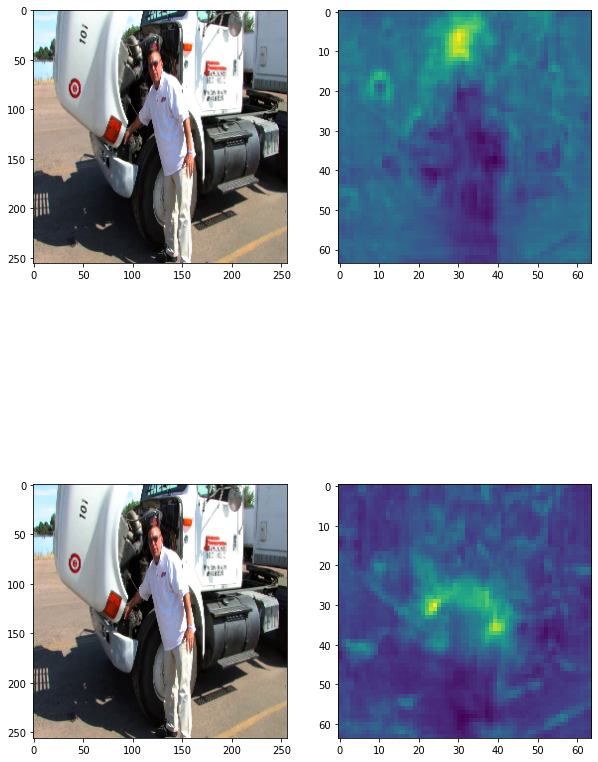


PCK@0.5: {'r ankle': 33.15926892950392, 'r knee': 38.66809881847476, 'r hip': 41.60206718346253, 'l hip': 35.65292096219931, 'l knee': 34.01069518716577, 'l ankle': 30.82901554404145, 'pelvis': 73.81158167675022, 'thorax': 86.91275167785236, 'upper neck': 87.08053691275168, 'head top': 76.4261744966443, 'r wrist': 38.63636363636363, 'r elbow': 33.80753138075313, 'r shoulder': 47.31993299832496, 'l shoulder': 42.05685618729097, 'l elbow': 33.7248322147651, 'l wrist': 32.233502538071065}
Train Loss on epoch 2: 18.377345591006073
Val Loss on epoch 2: 22.539964209662543


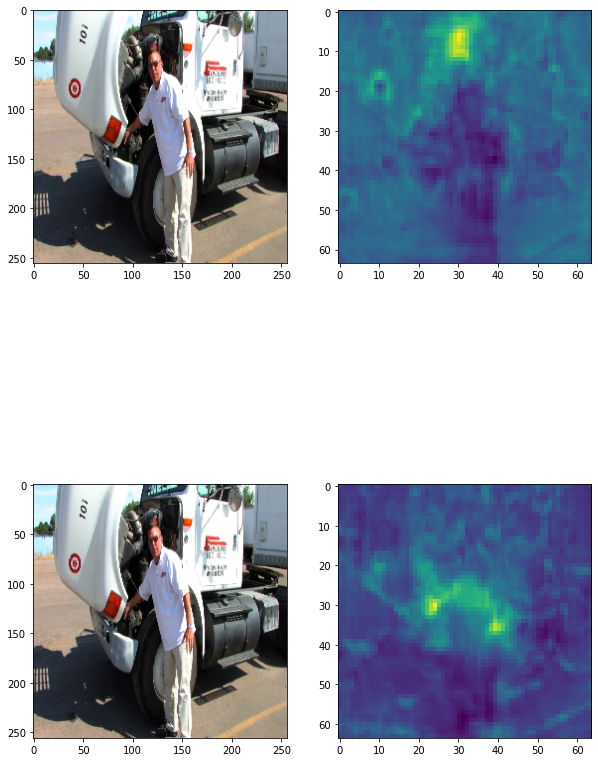


PCK@0.5: {'r ankle': 35.24804177545692, 'r knee': 38.23845327604726, 'r hip': 39.10422049956934, 'l hip': 38.659793814432994, 'l knee': 35.93582887700535, 'l ankle': 34.97409326424871, 'pelvis': 73.2065687121867, 'thorax': 87.08053691275168, 'upper neck': 88.17114093959731, 'head top': 76.09060402684564, 'r wrist': 36.53198653198653, 'r elbow': 31.04602510460251, 'r shoulder': 43.551088777219434, 'l shoulder': 41.63879598662207, 'l elbow': 33.557046979865774, 'l wrist': 35.70219966159052}
Train Loss on epoch 3: 18.24252109112947
Val Loss on epoch 3: 22.580820337931314


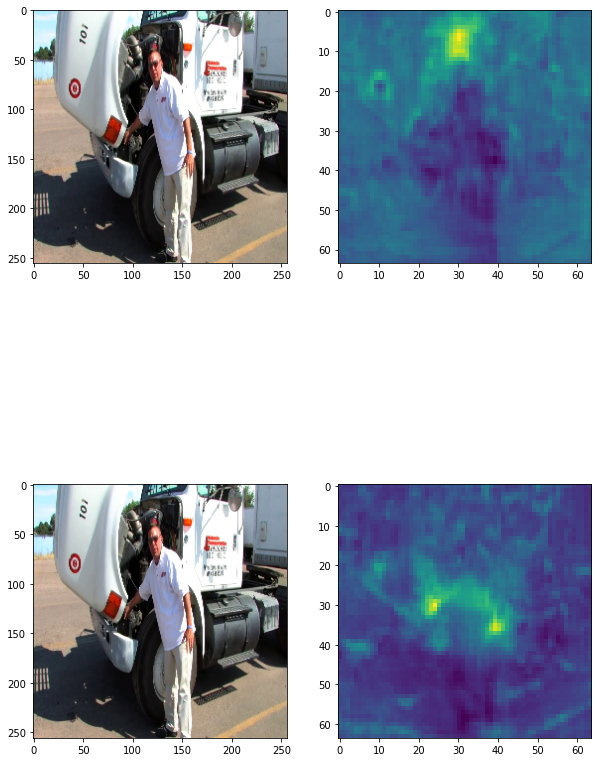


PCK@0.5: {'r ankle': 36.55352480417754, 'r knee': 39.31256713211601, 'r hip': 47.20068906115418, 'l hip': 48.10996563573883, 'l knee': 39.67914438502674, 'l ankle': 34.715025906735754, 'pelvis': 73.37942955920485, 'thorax': 87.5, 'upper neck': 86.40939597315436, 'head top': 75.83892617449665, 'r wrist': 37.20538720538721, 'r elbow': 32.46861924686193, 'r shoulder': 52.01005025125628, 'l shoulder': 47.90969899665552, 'l elbow': 34.144295302013425, 'l wrist': 34.686971235194584}
Train Loss on epoch 4: 18.09215324235999
Val Loss on epoch 4: 22.4954892900255


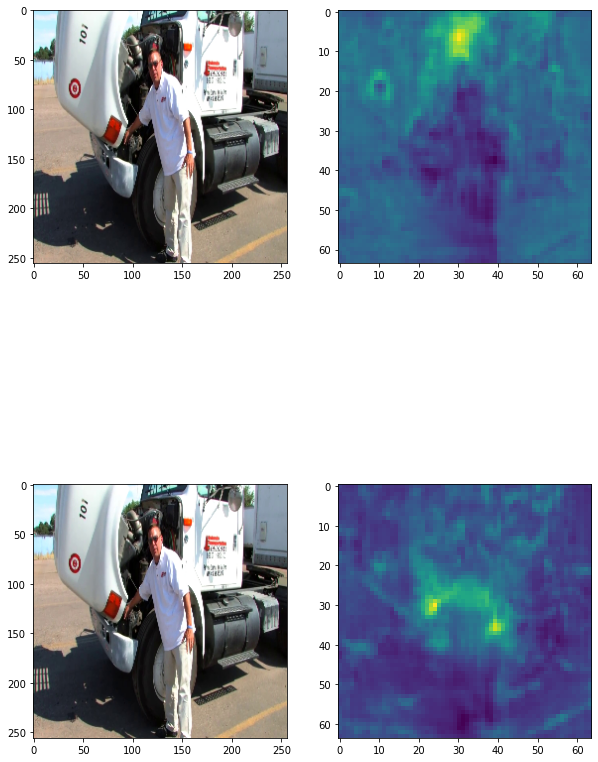


PCK@0.5: {'r ankle': 35.900783289817234, 'r knee': 38.99033297529538, 'r hip': 45.82256675279931, 'l hip': 43.81443298969072, 'l knee': 35.50802139037433, 'l ankle': 34.58549222797927, 'pelvis': 75.02160760587728, 'thorax': 88.33892617449665, 'upper neck': 87.33221476510067, 'head top': 75.75503355704699, 'r wrist': 37.03703703703704, 'r elbow': 33.55648535564853, 'r shoulder': 55.61139028475712, 'l shoulder': 51.00334448160535, 'l elbow': 35.98993288590604, 'l wrist': 35.786802030456855}
Train Loss on epoch 5: 17.963153503252112
Val Loss on epoch 5: 22.528310860527885


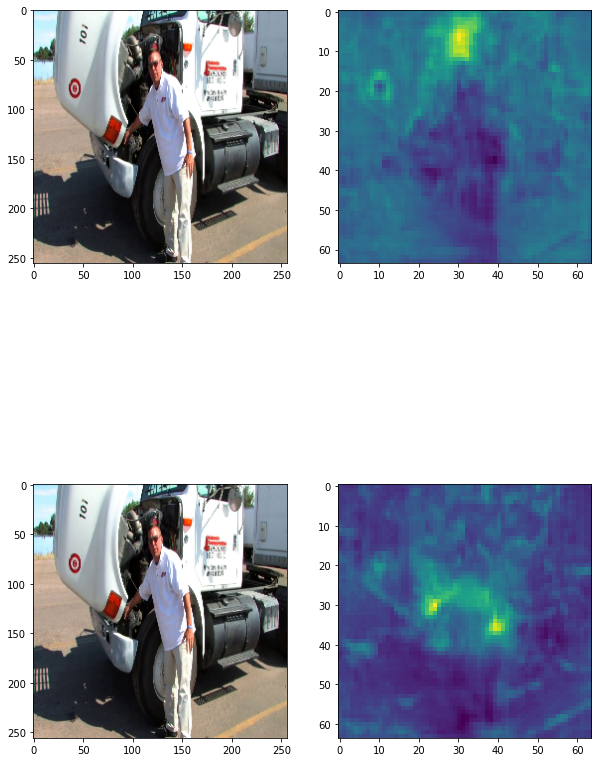


PCK@0.5: {'r ankle': 34.20365535248042, 'r knee': 39.849624060150376, 'r hip': 39.70714900947459, 'l hip': 33.84879725085911, 'l knee': 33.04812834224599, 'l ankle': 33.80829015544041, 'pelvis': 74.07087294727745, 'thorax': 88.33892617449665, 'upper neck': 87.83557046979867, 'head top': 77.43288590604027, 'r wrist': 38.72053872053872, 'r elbow': 33.30543933054393, 'r shoulder': 49.66499162479062, 'l shoulder': 38.79598662207358, 'l elbow': 32.718120805369125, 'l wrist': 33.16412859560068}
Train Loss on epoch 6: 17.874661599034848
Val Loss on epoch 6: 22.529148864746094


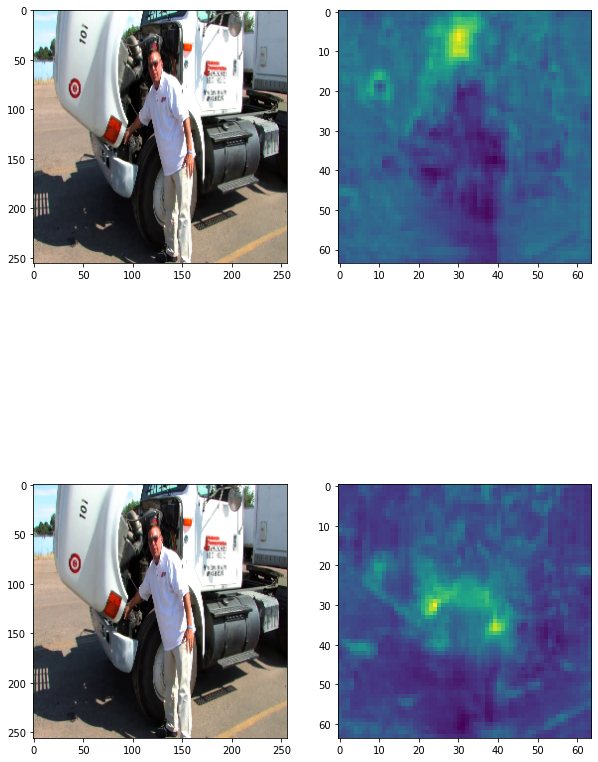


PCK@0.5: {'r ankle': 33.15926892950392, 'r knee': 40.06444683136412, 'r hip': 41.08527131782946, 'l hip': 38.144329896907216, 'l knee': 35.08021390374332, 'l ankle': 37.30569948186528, 'pelvis': 74.50302506482281, 'thorax': 88.17114093959731, 'upper neck': 86.91275167785236, 'head top': 76.09060402684564, 'r wrist': 37.20538720538721, 'r elbow': 31.715481171548117, 'r shoulder': 50.41876046901172, 'l shoulder': 41.22073578595318, 'l elbow': 33.89261744966443, 'l wrist': 35.70219966159052}
Train Loss on epoch 7: 17.766556582243545
Val Loss on epoch 7: 22.688751390245226


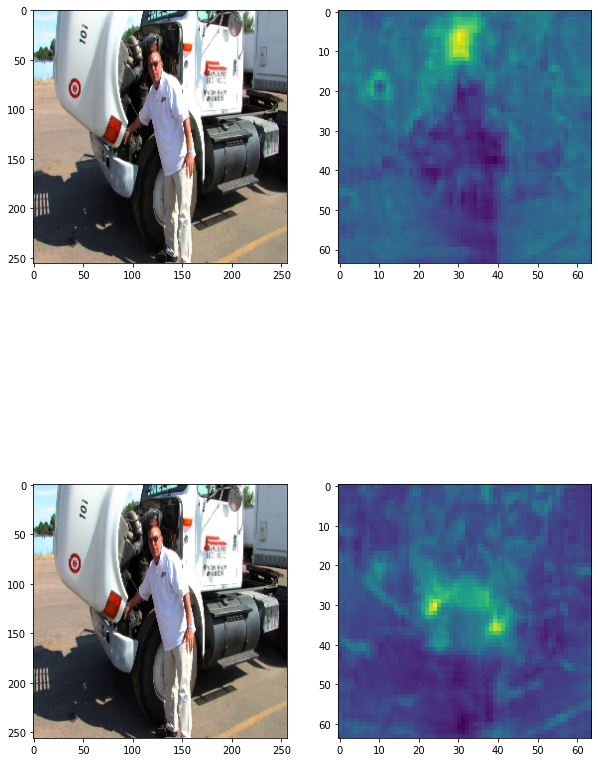


PCK@0.5: {'r ankle': 34.595300261096604, 'r knee': 38.56068743286789, 'r hip': 44.53057708871662, 'l hip': 38.05841924398625, 'l knee': 37.219251336898395, 'l ankle': 34.97409326424871, 'pelvis': 73.98444252376837, 'thorax': 88.42281879194631, 'upper neck': 87.33221476510067, 'head top': 77.01342281879194, 'r wrist': 38.215488215488215, 'r elbow': 29.8744769874477, 'r shoulder': 50.33500837520938, 'l shoulder': 45.23411371237458, 'l elbow': 36.07382550335571, 'l wrist': 34.60236886632826}
Train Loss on epoch 8: 17.605087893942127
Val Loss on epoch 8: 22.628856531778972


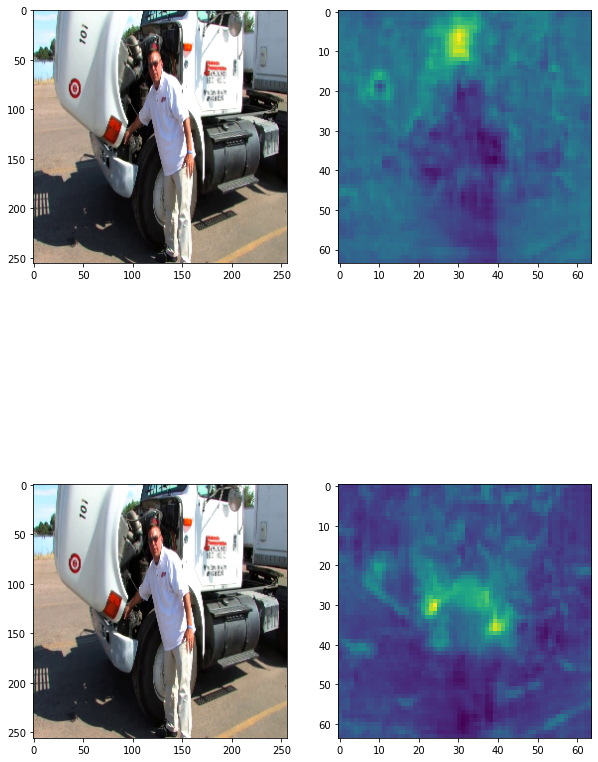


PCK@0.5: {'r ankle': 35.24804177545692, 'r knee': 41.67561761546724, 'r hip': 47.286821705426355, 'l hip': 44.75945017182131, 'l knee': 36.898395721925134, 'l ankle': 34.196891191709845, 'pelvis': 73.8980121002593, 'thorax': 88.6744966442953, 'upper neck': 87.5, 'head top': 77.09731543624162, 'r wrist': 39.141414141414145, 'r elbow': 34.47698744769874, 'r shoulder': 56.53266331658291, 'l shoulder': 47.74247491638796, 'l elbow': 33.9765100671141, 'l wrist': 35.53299492385787}
Train Loss on epoch 9: 17.559263685475226
Val Loss on epoch 9: 22.58479864332411


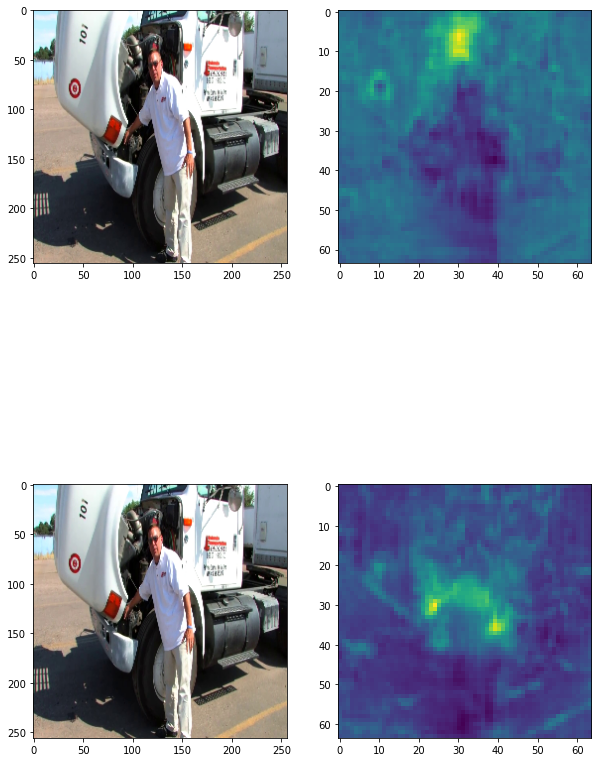

KeyboardInterrupt: ignored

In [ ]:
train(train_loader, model, criterion, optimizer, 10, val_dataset[4][0], sheduler, val_loader)

In [ ]:
torch.save(model.state_dict(), 'mpii_model.pt')